# Final Notebook 
Team Mangonadas
Andres Gonzalez
Dani Hoague

In [1]:
#Import packages
import geopandas as gpd
import pandas as pd
import plotly.express as px
from sodapy import Socrata
import folium
import matplotlib
import matplotlib.pyplot as plt
import esda
from esda.moran import Moran, Moran_Local
import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation
import libpysal as lps
import numpy as np 
import seaborn as sns
# to explore point patterns
from pointpats import centrography
from matplotlib.patches import Ellipse
import ipywidgets as widgets
from ipywidgets import interact, interact_manual

## Merging the EJSM and census tracts data

Our research questions asks: Is their a correlation between proximity to toxic hazards and the degree of policing that occurs in these communities? The primary source of our data will draw from an index of Enviornmental Justice Screening Method developed by USC PERE and Occidental College for use by the City of Los Angeles. This information creates an index of scores that include Proximity to Hazards (HazScore), standards of public health (HealthScore), social vulnerability indicators (SV), and Climage change vulnerability (CCVscore). The researchers then summed these numbers together to create a cumulative impact score (CIScore). Although this data captures information in 2015, the dataset can provide a recent and robust standard that captures environmental disparities by census tracts to measure policing against. 

In [2]:
#Read in EJSM df and make string of tracts to be named
df = pd.read_csv(
'Data/EJSM_Scores/EJSM_Scores (1).csv' ,
dtype={
    'Tract_1':str
})

In [3]:
#Add number zero leading the FIPS code for merging the data with the census tract data
df['Tract_1'] = df['Tract_1'].str.zfill(11)
df.head()

,OBJECTID,Tract_1,CIscore,HazScore,HealthScore,SVscore,CCVscore,Shape__Area,Shape__Length
0,1,06037920336,10,3,1,4,2,2.438560e+06,8124.373091
1,2,06037920044,4,1,1,1,1,1.470811e+06,5545.298452
2,3,06037573003,13,5,3,3,2,6.528168e+05,3310.743793
3,4,06037571704,13,3,2,4,4,6.994011e+05,4113.477175
4,5,06037570403,17,5,3,5,4,8.317839e+05,3887.000394


In [4]:
#Import 2012 census data
tracts=gpd.read_file('Data/CensusData2012/census-tracts-2012.geojson')
print(tracts)

                     kind  external_id         name  \
0     Census Tract (2012)  06037101110  06037101110   
1     Census Tract (2012)  06037101122  06037101122   
2     Census Tract (2012)  06037101210  06037101210   
3     Census Tract (2012)  06037101220  06037101220   
4     Census Tract (2012)  06037101300  06037101300   
...                   ...          ...          ...   
2341  Census Tract (2012)  06037980031  06037980031   
2342  Census Tract (2012)  06037980033  06037980033   
2343  Census Tract (2012)  06037990100  06037990100   
2344  Census Tract (2012)  06037990200  06037990200   
2345  Census Tract (2012)  06037990300  06037990300   

                               slug                                    set  \
0     06037101110-census-tract-2012  /1.0/boundary-set/census-tracts-2012/   
1     06037101122-census-tract-2012  /1.0/boundary-set/census-tracts-2012/   
2     06037101210-census-tract-2012  /1.0/boundary-set/census-tracts-2012/   
3     06037101220-census-tr

In [5]:
#List column names 
list(tracts)

['kind',
 'external_id',
 'name',
 'slug',
 'set',
 'metadata',
 'resource_uri',
 'geometry']

In [6]:
#Select unwanted columns
columns_to_drop = ['set','kind','resource_uri','metadata']
#read columns 
tracts.head()

,kind,external_id,name,slug,set,metadata,resource_uri,geometry
0,Census Tract (2012),06037101110,06037101110,06037101110-census-tract-2012,/1.0/boundary-set/census-tracts-2012/,"{'INTPTLAT': '+34.2594737', 'NAME': '1011.10',...",/1.0/boundary/06037101110-census-tract-2012/,"MULTIPOLYGON (((-118.30229 34.25870, -118.3007..."
1,Census Tract (2012),06037101122,06037101122,06037101122-census-tract-2012,/1.0/boundary-set/census-tracts-2012/,"{'INTPTLAT': '+34.2677213', 'NAME': '1011.22',...",/1.0/boundary/06037101122-census-tract-2012/,"MULTIPOLYGON (((-118.30333 34.27354, -118.3031..."
2,Census Tract (2012),06037101210,06037101210,06037101210-census-tract-2012,/1.0/boundary-set/census-tracts-2012/,"{'INTPTLAT': '+34.2529724', 'NAME': '1012.10',...",/1.0/boundary/06037101210-census-tract-2012/,"MULTIPOLYGON (((-118.29945 34.25598, -118.2859..."
3,Census Tract (2012),06037101220,06037101220,06037101220-census-tract-2012,/1.0/boundary-set/census-tracts-2012/,"{'INTPTLAT': '+34.2516085', 'NAME': '1012.20',...",/1.0/boundary/06037101220-census-tract-2012/,"MULTIPOLYGON (((-118.28592 34.24896, -118.2859..."
4,Census Tract (2012),06037101300,06037101300,06037101300-census-tract-2012,/1.0/boundary-set/census-tracts-2012/,"{'INTPTLAT': '+34.2487732', 'NAME': '1013', 'I...",/1.0/boundary/06037101300-census-tract-2012/,"MULTIPOLYGON (((-118.27247 34.23253, -118.2719..."


In [7]:
#Drop unnecessary columns from tracts data
tracts = tracts.drop(columns_to_drop,axis=1)

In [8]:
#Show tracts info
tracts.info(verbose=True, null_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2346 entries, 0 to 2345
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   external_id  2346 non-null   object  
 1   name         2346 non-null   object  
 2   slug         2346 non-null   object  
 3   geometry     2346 non-null   geometry
dtypes: geometry(1), object(3)
memory usage: 73.4+ KB


In [9]:
#Isolate the FIPS code and geometry columns to match with the EJSM data
tracts = tracts[['name','geometry']]
tracts.head()

,name,geometry
0,06037101110,"MULTIPOLYGON (((-118.30229 34.25870, -118.3007..."
1,06037101122,"MULTIPOLYGON (((-118.30333 34.27354, -118.3031..."
2,06037101210,"MULTIPOLYGON (((-118.29945 34.25598, -118.2859..."
3,06037101220,"MULTIPOLYGON (((-118.28592 34.24896, -118.2859..."
4,06037101300,"MULTIPOLYGON (((-118.27247 34.23253, -118.2719..."


In [10]:
#Show isolated columns - COULD ADD tracts.columns
tracts.columns = ['FIPS','geometry']
tracts.head()

,FIPS,geometry
0,06037101110,"MULTIPOLYGON (((-118.30229 34.25870, -118.3007..."
1,06037101122,"MULTIPOLYGON (((-118.30333 34.27354, -118.3031..."
2,06037101210,"MULTIPOLYGON (((-118.29945 34.25598, -118.2859..."
3,06037101220,"MULTIPOLYGON (((-118.28592 34.24896, -118.2859..."
4,06037101300,"MULTIPOLYGON (((-118.27247 34.23253, -118.2719..."


In [11]:
#Rename Tract_1 to FIPS
df.columns = ['OBJECTID',
 'FIPS',
 'CIscore',
 'HazScore',
 'HealthScore',
 'SVscore',
 'CCVscore',
 'Shape__Area',
 'Shape__Length']
df.head()

,OBJECTID,FIPS,CIscore,HazScore,HealthScore,SVscore,CCVscore,Shape__Area,Shape__Length
0,1,06037920336,10,3,1,4,2,2.438560e+06,8124.373091
1,2,06037920044,4,1,1,1,1,1.470811e+06,5545.298452
2,3,06037573003,13,5,3,3,2,6.528168e+05,3310.743793
3,4,06037571704,13,3,2,4,4,6.994011e+05,4113.477175
4,5,06037570403,17,5,3,5,4,8.317839e+05,3887.000394


This section will explore the ejsm data by tracts

In [12]:
#List new df columns
list(df)

['OBJECTID',
 'FIPS',
 'CIscore',
 'HazScore',
 'HealthScore',
 'SVscore',
 'CCVscore',
 'Shape__Area',
 'Shape__Length']

In [13]:
#Merge data on the same object FIPS
tracts_ejsm=tracts.merge(df,on="FIPS")
#Show merge with census data
tracts_ejsm.head()
tracts_ejsm.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2342 entries, 0 to 2341
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   FIPS           2342 non-null   object  
 1   geometry       2342 non-null   geometry
 2   OBJECTID       2342 non-null   int64   
 3   CIscore        2342 non-null   int64   
 4   HazScore       2342 non-null   int64   
 5   HealthScore    2342 non-null   int64   
 6   SVscore        2342 non-null   int64   
 7   CCVscore       2342 non-null   int64   
 8   Shape__Area    2342 non-null   float64 
 9   Shape__Length  2342 non-null   float64 
dtypes: float64(2), geometry(1), int64(6), object(1)
memory usage: 201.3+ KB


In [14]:
tracts_ejsm.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [15]:
#Describe stats by proximity to hazard score
tracts_ejsm['CIscore'].describe()

count    2342.000000
mean       12.007259
std         4.352322
min         0.000000
25%         9.000000
50%        12.000000
75%        15.000000
max        20.000000
Name: CIscore, dtype: float64

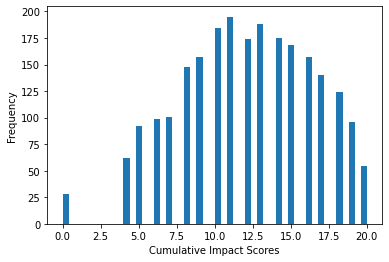

In [16]:
#Plot histogram for cumulative impact score
tracts_ejsm['CIscore'].plot.hist(bins=50),
plt.xlabel('Cumulative Impact Scores')
plt.ylabel('Frequency'),
plt.savefig('CIscore.png')

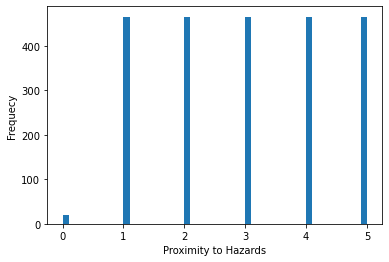

In [17]:
#Plot histogram for proximity to hazard score. It is grouped by the number of occurences. 
#Our not so great graph! Seeing this bar chart intrigued us to durther explore the variations between census tracts.
tracts_ejsm['HazScore'].plot.hist(bins=50)
plt.xlabel('Proximity to Hazards')
plt.ylabel('Frequecy'),
plt.savefig('HazScore_bar.png')

It’s unclear why the hazard score data is not distributed the same way as the cumulative impact score data. We wondered if it was because we had miswritten it or if the hazard occurrences were not visible on this bar graph. What is apparent is the average cumulative impact score of LA lying somewhere between 10.5-12.5. The cumulative score considers all the scores identified from the dataset included proximity to hazards, social vulnerability, climate vulnerability, and health vulnerability. 

In [18]:
#New object to show the sorted data- these are the top polluted census tracts. The census tracts that are shown as being the most polluted are also the most socially vulnerable.
tracts_ejsm_sorted = tracts_ejsm.sort_values(by='CIscore',ascending = False)
tracts_ejsm_sorted[['FIPS','CIscore','HazScore','SVscore']].head(10)

,FIPS,CIscore,HazScore,SVscore
1325,06037433501,20,5,5
1530,06037530301,20,5,5
594,06037211922,20,5,5
532,06037206032,20,5,5
533,06037206050,20,5,5
660,06037219300,20,5,5
581,06037211310,20,5,5
672,06037221302,20,5,5
719,06037228900,20,5,5
1637,06037535605,20,5,5


## Plots for EJSM hazard and cumulative impact scores by tracts

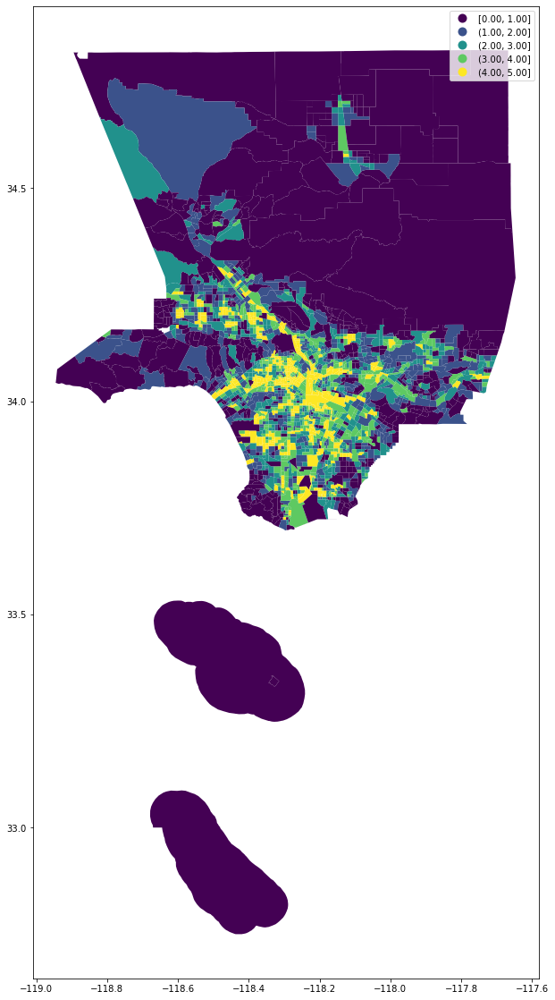

In [19]:
#Plot represents the proximity to environmental hazards score by equal intervals 
#We can see that the most polluted areas are in south central LA county 
tracts_ejsm.plot(figsize=(24,20),
                 column='HazScore',
                 legend=True, 
                 scheme='equal_interval')

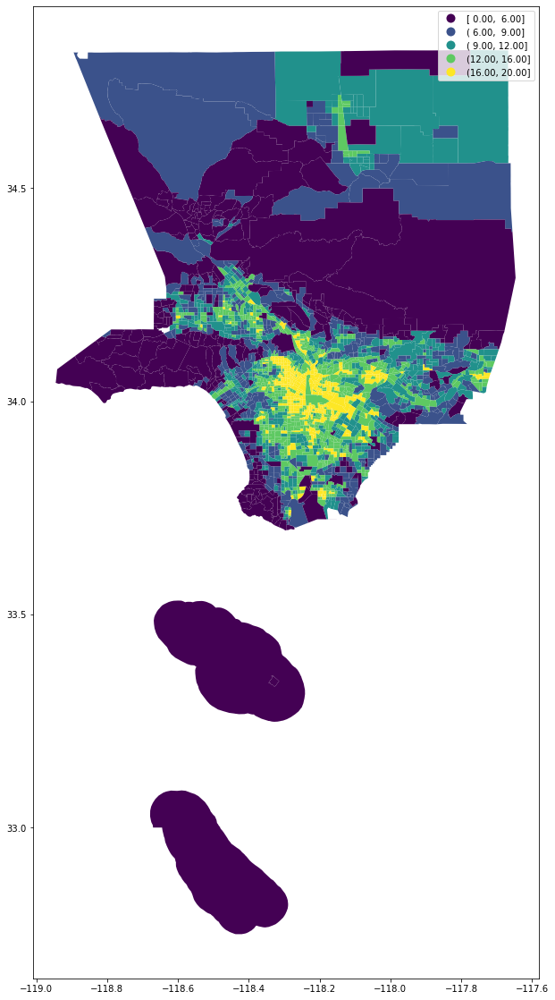

In [20]:
#Plot represents the cumulative impact scores separated by natural breaks
#The map shows increased variation because of the integrated scores
tracts_ejsm.plot(figsize=(24,20),
                 column='CIscore',
                 legend=True, 
                 scheme='NaturalBreaks')

This Chloropleth map provides us with a background map that will kick off the rest of our work. We chose hazard scores because while the cumulative impact was meaningful, we wanted to focus on a standard that could be more decisively measured (proximity to environmental hazards in the form of pollutants) rather than other measurements. Measurements include a social vulnerability that could be more skewed based on indicators defined by the source (in this case, USC/Occidental College). For example, although poverty and policing can be linked, we wanted to see if sites that were contaminated or close to toxic sites (such as Exide) would have a significant relationship to policing.

# Import Arrest data 

In [21]:
#Importing our arrest 2020 data using an API
client = Socrata("data.lacity.org", None)
results = client.get("amvf-fr72", 
                     limit=50000,
                     where = "(arst_date between '2020-01-01T00:00:00' and '2020-10-30T00:00:00') AND (grp_description in ('Aggravated Assault','Miscellaneous Other Violations','Driving Under Influence','Other Assaults','Narcotic Drug Laws'))",
                     order='arst_date desc')
df =pd.DataFrame.from_records(results)

In [22]:
df.shape

(31676, 25)

In [23]:
#Get description of arrest data 
df.grp_description.unique()

array(['Aggravated Assault', 'Miscellaneous Other Violations',
       'Narcotic Drug Laws', 'Driving Under Influence', 'Other Assaults'],
      dtype=object)

In [24]:
#Examining all data types in the df for floats
df.lon = df.lon.astype('float')
df.lat = df.lat.astype('float')

In [25]:
#Plotly bar graph to examine the total arrests by LAPD in January-October 30th of 2020
px.bar(df,
       x='arst_date',
       title='LAPD Arrests in January-October 30th of 2020',
       labels={'arst_date':'Arrest date','counts':'Number of arrests'}
      ) 

This has been a graph we may already be familiar with from class, but it’s interesting to note how arrests boom in the summer months and during the'20 uprisings. What would these look like across time? When hearing about the ‘92 uprising, anecdotes of that period recount how heat and power shortages aggravated communities already frustrated and fed up with the especially pervasive policing practices. While it would require a separate research project to examine the relationship between weather and policing, it’s important to note how many people, particularly folks of color, we’re stuck at home due to quarantine during summer, and many lacked air conditioning (or income to pay for utilities).

In [26]:
#Index arrest charge value counts
arrest_by_charge = df.grp_description.value_counts().reset_index()
arrest_by_charge

,index,grp_description
0,Miscellaneous Other Violations,8699
1,Aggravated Assault,7073
2,Narcotic Drug Laws,5596
3,Driving Under Influence,5205
4,Other Assaults,5103


In [27]:
#Index arrest charge value counts
arrest_by_charge = df.grp_description.value_counts().reset_index()
arrest_by_charge

,index,grp_description
0,Miscellaneous Other Violations,8699
1,Aggravated Assault,7073
2,Narcotic Drug Laws,5596
3,Driving Under Influence,5205
4,Other Assaults,5103


In [28]:
#Configure geometry for crime geodataframe
crime = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.lon, df.lat))
crime.drop(crime[crime.lon==0].index,inplace=True)

## Plotting the arrest data

We have now been able to pull together the data for our index and used it to create a geodataframe in order to visualize. By choosing these crimes to focus on we created an index of beahviors we believe based on literature, could have some positive relationship with proximity to toxic hazards. While we are not making the argument that people proximate to hazards are more prone to assault, or drug use, we are trying to identify a set of crimes that members of these communities might be more susceptible to being policed for. For example, mental health episodes are often seen as an act of violence or assault by police, and could be a possible indicator for how behavior is policed. Likewise, we originally were looking at Drunkeness and Distrubing the Peace, but they were in such small numbers, they may not reflect coping mechanisms or side effects of proximity to hazards. Though we chose Narcotic Drug Laws and Driving Under Influence to replace these, we finished the project feeling thiese indicators could be problematized and replaced in order to further a more representative index.

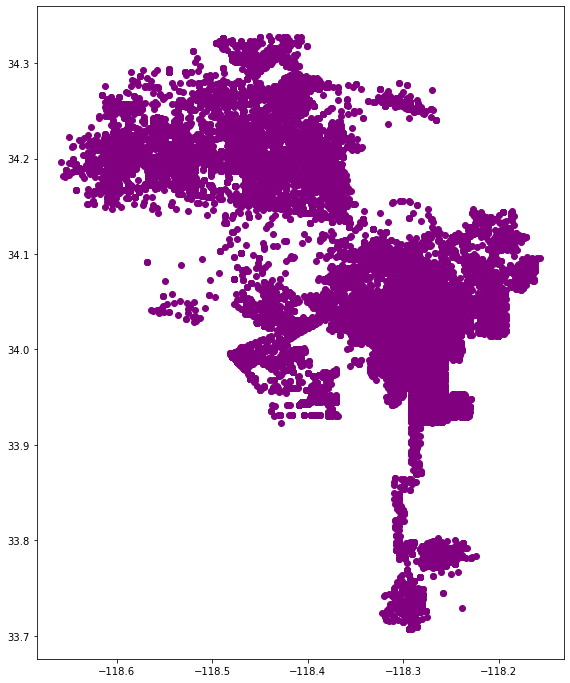

In [29]:
#Scatterplot of crime data
crime.plot(figsize=(12,12),color='purple')

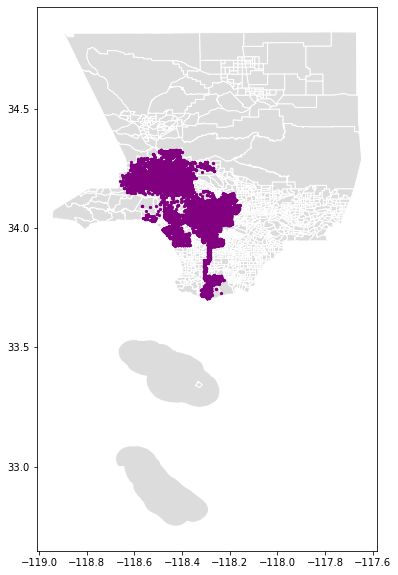

In [30]:
#Add base from tracts data
base = tracts_ejsm.plot(figsize=(12,10),color='gainsboro', edgecolor='white')

ax = crime.plot(ax=base, color='purple', markersize=5)

In [31]:
#Print total bounds of data points 
minx, miny, maxx, maxy = crime.geometry.total_bounds
print(minx)
print(maxx)
print(miny)
print(maxy)

-118.659
-118.1569
33.707
34.3283


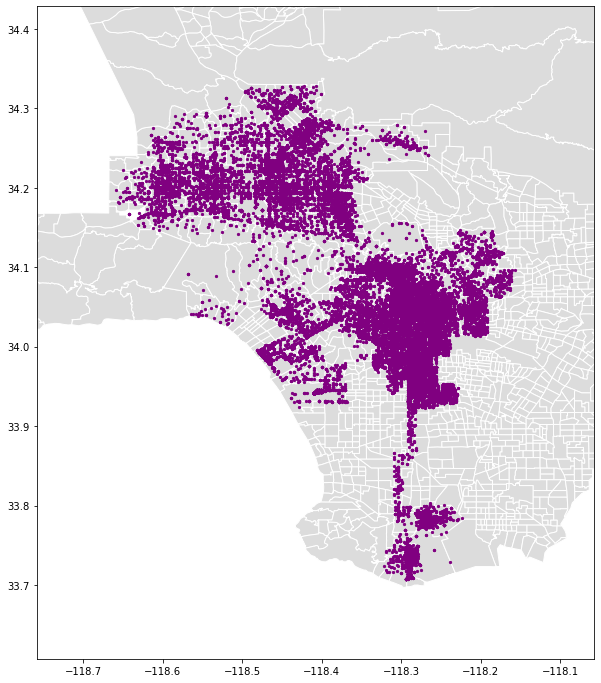

In [32]:
#Print map with within closer boundaries
base = tracts_ejsm.plot(figsize=(12,12),color='gainsboro', edgecolor='white')
ax = crime.plot(ax=base, marker='o', color='purple', markersize=5)
ax.set_xlim(minx - .1, maxx + .1)
ax.set_ylim(miny - .1, maxy + .1)
ax

In [33]:
#Configure coordinate reference system for tracts to join the two dataframes
tracts_ejsm.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [34]:
#Configure coordinate reference system for crime
crime.set_crs(epsg=4326, inplace=True)
crime.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Our data now contains the surface and base map data as geoframes in the same projection system. We are now on the verge of tranisition our data into a more readable format and consolidate the data we want to lock at which is amount of indexed arrests to environmental hazard scores. 

# Exploring the EJSM and arrest data by tracts

In [35]:
#Join tracts_ejsm and crime data
join = gpd.sjoin(tracts_ejsm,
                 crime,
                 how='right')

In [36]:
join.head()

,index_left,FIPS,OBJECTID,CIscore,HazScore,HealthScore,SVscore,CCVscore,Shape__Area,Shape__Length,...,location,lat,lon,location_1,bkg_date,bkg_time,bgk_location,bkg_loc_cd,crsst,geometry
5567,0.0,06037101110,1464.0,10.0,3.0,1.0,3.0,3.0,1.677572e+06,5561.28341,...,7700 FOOTHILL BL,34.2567,-118.3002,"{'type': 'Point', 'coordinates': [-118.3002, 3...",2020-09-05T00:00:00.000,0218,VALLEY - JAIL DIV,4279,NaN,POINT (-118.30020 34.25670)
2862,0.0,06037101110,1464.0,10.0,3.0,1.0,3.0,3.0,1.677572e+06,5561.28341,...,7700 FOOTHILL BL,34.2567,-118.3002,"{'type': 'Point', 'coordinates': [-118.3002, 3...",2020-10-02T00:00:00.000,0057,VALLEY - JAIL DIV,4279,NaN,POINT (-118.30020 34.25670)
25845,0.0,06037101110,1464.0,10.0,3.0,1.0,3.0,3.0,1.677572e+06,5561.28341,...,FOOTHILL,34.2575,-118.3010,"{'type': 'Point', 'coordinates': [-118.301, 34...",NaN,NaN,NaN,NaN,WYNGATE,POINT (-118.30100 34.25750)
7469,0.0,06037101110,1464.0,10.0,3.0,1.0,3.0,3.0,1.677572e+06,5561.28341,...,7600 MACHREA ST,34.2588,-118.2979,"{'type': 'Point', 'coordinates': [-118.2979, 3...",2020-08-18T00:00:00.000,2009,VALLEY - JAIL DIV,4279,NaN,POINT (-118.29790 34.25880)
7745,0.0,06037101110,1464.0,10.0,3.0,1.0,3.0,3.0,1.677572e+06,5561.28341,...,7400 APPERSON ST,34.2560,-118.2932,"{'type': 'Point', 'coordinates': [-118.2932, 3...",2020-08-16T00:00:00.000,0206,VALLEY - JAIL DIV,4279,NaN,POINT (-118.29320 34.25600)


In [37]:
join.sample(5)

,index_left,FIPS,OBJECTID,CIscore,HazScore,HealthScore,SVscore,CCVscore,Shape__Area,Shape__Length,...,location,lat,lon,location_1,bkg_date,bkg_time,bgk_location,bkg_loc_cd,crsst,geometry
3482,240.0,06037128400,719.0,12.0,5.0,2.0,2.0,3.0,2.524473e+06,8320.862821,...,OXNARD ST,34.1794,-118.4662,"{'type': 'Point', 'coordinates': [-118.4662, 3...",2020-09-25T00:00:00.000,1052,VALLEY - JAIL DIV,4279,SEPULVEDA BL,POINT (-118.46620 34.17940)
12682,829.0,06037262302,1569.0,7.0,1.0,4.0,1.0,1.0,4.473564e+06,11850.490376,...,SANTA MONICA FY,34.0738,-118.4768,"{'type': 'Point', 'coordinates': [-118.4768, 3...",2020-06-24T00:00:00.000,0102,VALLEY - JAIL DIV,4279,WILSHIRE BL,POINT (-118.47680 34.07380)
30480,2335.0,06037980024,280.0,11.0,3.0,5.0,1.0,2.0,1.213515e+07,17052.386307,...,BALBOA,34.1757,-118.4846,"{'type': 'Point', 'coordinates': [-118.4846, 3...",NaN,NaN,NaN,NaN,VICTORY,POINT (-118.48460 34.17570)
31357,898.0,06037272100,944.0,8.0,1.0,4.0,2.0,1.0,1.749189e+06,5451.132165,...,VENICE,34.0015,-118.4380,"{'type': 'Point', 'coordinates': [-118.438, 34...",NaN,NaN,NaN,NaN,WADE,POINT (-118.43800 34.00150)
5017,866.0,06037267700,1913.0,15.0,5.0,5.0,2.0,3.0,1.187607e+06,4485.388885,...,BELOIT,34.0416,-118.4428,"{'type': 'Point', 'coordinates': [-118.4428, 3...",2020-09-09T00:00:00.000,2139,PACIFIC,4214,LA GRANGE,POINT (-118.44280 34.04160)


In [38]:
#Subset the data from join
df = pd.DataFrame(join,columns=['arst_date','rpt_id','grp_description','arst_typ_cd','HazScore','CIscore','FIPS','lat','lon','geometry'])
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 31826 entries, 5567 to 31632
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   arst_date        31826 non-null  object  
 1   rpt_id           31826 non-null  object  
 2   grp_description  31826 non-null  object  
 3   arst_typ_cd      31826 non-null  object  
 4   HazScore         31600 non-null  float64 
 5   CIscore          31600 non-null  float64 
 6   FIPS             31600 non-null  object  
 7   lat              31826 non-null  float64 
 8   lon              31826 non-null  float64 
 9   geometry         31826 non-null  geometry
dtypes: float64(4), geometry(1), object(5)
memory usage: 2.7+ MB


In [39]:
#Subset of the joined dataframes 
#We are keeping these columns because our analysis focuses on the HazScore and description of the charges
df.head()

,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,FIPS,lat,lon,geometry
5567,2020-09-04T00:00:00.000,6005984,Driving Under Influence,M,3.0,10.0,06037101110,34.2567,-118.3002,POINT (-118.30020 34.25670)
2862,2020-10-01T00:00:00.000,6023564,Aggravated Assault,F,3.0,10.0,06037101110,34.2567,-118.3002,POINT (-118.30020 34.25670)
25845,2020-02-13T00:00:00.000,201605850,Narcotic Drug Laws,M,3.0,10.0,06037101110,34.2575,-118.3010,POINT (-118.30100 34.25750)
7469,2020-08-18T00:00:00.000,5994330,Aggravated Assault,F,3.0,10.0,06037101110,34.2588,-118.2979,POINT (-118.29790 34.25880)
7745,2020-08-15T00:00:00.000,5992659,Driving Under Influence,F,3.0,10.0,06037101110,34.2560,-118.2932,POINT (-118.29320 34.25600)


Here we follow Yoh’s steps more closely, but the aggravated arrests don’t tell us much. We’re trying to figure out crimes linked explicitly to environmental hazards. For now, we want to keep this large dataset because we want to be able to pick them out later depending on what crimes we want to analyze in the nexus with environmental hazards.

In [40]:
#These are the tracts with the highest number of arrests. We included this as a priliminary step to mapping the full counts. 
crime_by_tracts = join.FIPS.value_counts().rename_axis('Tract').reset_index(name='crime_count')
crime_by_tracts.head()

,Tract,crime_count
0,06037980028,802
1,06037206300,550
2,06037207710,286
3,06037128210,265
4,06037207400,245


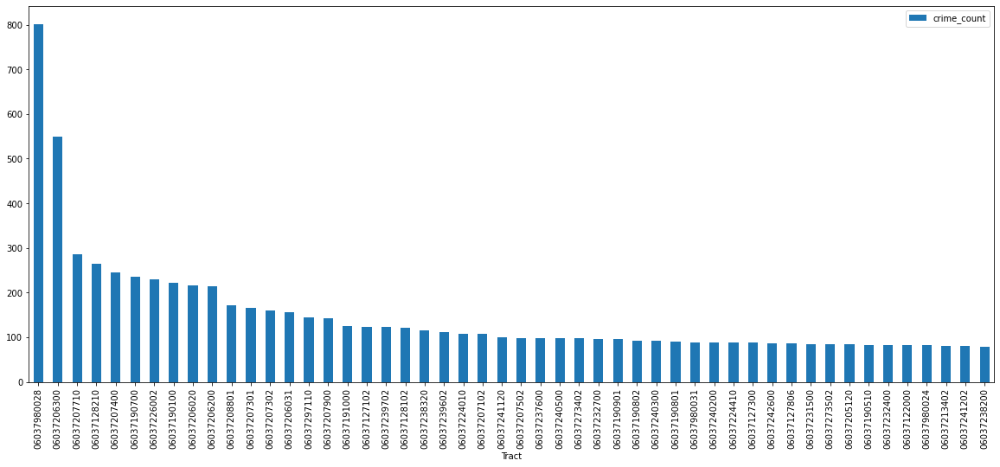

In [41]:
#This is a visualization to compare the amount of arrests in different census tracts
crime_by_tracts[:50].plot.bar(figsize=(20,8),x='Tract',y='crime_count')

This bar graph tells us the crime by census tract, but we can only guess what that is. It would be useful to bring this into the function, but we’re looking for a better way of organizing and visualizing the data. Instead of looking at specific census tracts themselves, our goal is to understand the interconnected relationship between proximity to hazards (such as pollution) and seeing what charges the police are giving people in that area. Surprisingly, the census tract with the most crimes (06037980028) is the one belonging to the airport and in between the Chevron Oil Refinery and the Ballon Wetlands


In [42]:
#Grouped data by the description of arrest. Here, the FIPS out of order because we are descibing a full count of charge descriptions. 
df.groupby(['grp_description']).count()

,arst_date,rpt_id,arst_typ_cd,HazScore,CIscore,FIPS,lat,lon,geometry
grp_description,,,,,,,,,
Aggravated Assault,7112,7112,7112,7067,7067,7067,7112,7112,7112
Driving Under Influence,5232,5232,5232,5190,5190,5190,5232,5232,5232
Miscellaneous Other Violations,8751,8751,8751,8683,8683,8683,8751,8751,8751
Narcotic Drug Laws,5611,5611,5611,5565,5565,5565,5611,5611,5611
Other Assaults,5120,5120,5120,5095,5095,5095,5120,5120,5120


In [43]:
#Group data by the FIPS code to explore the meaning of the counts in each census tract. 
df.groupby(['FIPS']).count()

,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,lat,lon,geometry
FIPS,,,,,,,,,
06037101110,17,17,17,17,17,17,17,17,17
06037101122,6,6,6,6,6,6,6,6,6
06037101210,17,17,17,17,17,17,17,17,17
06037101220,15,15,15,15,15,15,15,15,15
06037101300,10,10,10,10,10,10,10,10,10
...,...,...,...,...,...,...,...,...,...
06037980023,1,1,1,1,1,1,1,1,1
06037980024,82,82,82,82,82,82,82,82,82
06037980026,3,3,3,3,3,3,3,3,3


In [44]:
#Data is grouped for counts of reports in tracts. 
df_grouped=df.groupby(['FIPS','grp_description','lat','lon','arst_date']).count()[['rpt_id']]
df_grouped.head(50)

rpt_id
FIPS        grp_description                lat     lon       arst_date                      
06037101110 Aggravated Assault             34.2567 -118.3002 2020-10-01T00:00:00.000       1
                                           34.2588 -118.2979 2020-08-18T00:00:00.000       1
                                           34.2611 -118.2857 2020-06-09T00:00:00.000       1
                                           34.2632 -118.2957 2020-03-05T00:00:00.000       1
            Driving Under Influence        34.2560 -118.2932 2020-08-15T00:00:00.000       1
                                           34.2567 -118.3002 2020-09-04T00:00:00.000       1
                                           34.2595 -118.2930 2020-10-07T00:00:00.000       1
            Miscellaneous Other Violations 34.2595 -118.2930 2020-08-16T00:00:00.000       1
            Narcotic Drug Laws             34.2575 -118.3010 2020-02-13T00:00:00.000       1
                                           34.2595 -118.2930 2020-02-05T00:00:00.000       1
                                                             2020-02-18T00:00:00.000       1
                                                             2020-05-15T00:00:00.000       1
                                                             2020-05-21T00:00:00.000       1
            Other Assaults                 34.2578 -118.2932 2020-09-10T00:00:00.000       1
                                           34.2595 -118.2930 2020-02-20T00:00:00.000       1
                                                             2020-06-25T00:00:00.000       1
                                                             2020-07-27T00:00:00.000       1
06037101122 Aggravated Assault             34.2559 -118.2840 2020-04-04T00:00:00.000       1
                                           34.2655 -118.2931 2020-06-02T00:00:00.000       1
            Miscellaneous Other Violations 34.2580 -118.2849 2020-10-08T00:00:00.000       1
            Other Assaults                 34.2632 -118.2943 2020-06-14T00:00:00.000       1
                                           34.2769 -118.2964 2020-03-27T00:00:00.000       1
                                                             2020-04-02T00:00:00.000       1
06037101210 Aggravated Assault             34.2523 -118.2932 2020-06-19T00:00:00.000       1
                                                   -118.2898 2020-06-01T00:00:00.000       1
                                                   -118.2874 2020-06-21T00:00:00.000       1
                                                             2020-07-15T00:00:00.000       1
                                                             2020-08-22T00:00:00.000       1
                                                             2020-10-14T00:00:00.000       1
                                           34.2544 -118.2860 2020-07-26T00:00:00.000       1
            Driving Under Influence        34.2530 -118.2907 2020-02-01T00:00:00.000       1
            Miscellaneous Other Violations 34.2530 -118.2907 2020-03-07T00:00:00.000       2
                                           34.2545 -118.2955 2020-02-07T00:00:00.000       1
                                           34.2551 -118.2964 2020-09-01T00:00:00.000       1
            Narcotic Drug Laws             34.2523 -118.2886 2020-09-08T00:00:00.000       1
            Other Assaults                 34.2523 -118.2898 2020-05-13T00:00:00.000       1
                                                   -118.2874 2020-10-14T00:00:00.000       1
                                           34.2542 -118.2943 2020-01-09T00:00:00.000       1
                                                   -118.2932 2020-04-23T00:00:00.000       1
06037101220 Aggravated Assault             34.2476 -118.2794 2020-05-24T00:00:00.000       1
                                           34.2516 -118.2816 2020-07-01T00:00:00.000       1
                                           34.2520 -118.2835 2020-07-01T00:00:00.000   

In [45]:
#Flatten data to prep for bar graph and reset the index to include the group values 
df_flat = df_grouped.reset_index()
df_flat

,FIPS,grp_description,lat,lon,arst_date,rpt_id
0,06037101110,Aggravated Assault,34.2567,-118.3002,2020-10-01T00:00:00.000,1
1,06037101110,Aggravated Assault,34.2588,-118.2979,2020-08-18T00:00:00.000,1
2,06037101110,Aggravated Assault,34.2611,-118.2857,2020-06-09T00:00:00.000,1
3,06037101110,Aggravated Assault,34.2632,-118.2957,2020-03-05T00:00:00.000,1
4,06037101110,Driving Under Influence,34.2560,-118.2932,2020-08-15T00:00:00.000,1
...,...,...,...,...,...,...
29215,06037980031,Narcotic Drug Laws,33.7613,-118.2819,2020-09-25T00:00:00.000,1
29216,06037980031,Other Assaults,33.7167,-118.2842,2020-04-24T00:00:00.000,1
29217,06037980031,Other Assaults,33.7167,-118.2842,2020-09-18T00:00:00.000,1
29218,06037980031,Other Assaults,33.7254,-118.2812,2020-09-23T00:00:00.000,1


Look at how beautiful that index is. What is not shown in our flattened data frame is the amount of blood and tears (and lots of green tea caffeine) that helped us get to this point. Originally while our workflow was simple, things became more complicated as we tried to clean up our notebooks without taking away code that would serve us moving forward. This data frame allows us to see all types of crimes and arrest data across census tracts and their location. This provides us with the top-most layer for our future maps, in addition to a versatile data frame that can give temporal nuance to our maps, an attribute especially useful for the Kepler map. 

In [46]:
#Make plotly bar graph
fig = px.bar(df_flat,
       x='grp_description',
       y='rpt_id',
       title='Description of LAPD Arrests between January- October 30th of 2020',
       color='grp_description',
       labels={'grp_description':'Arrest Decription','rpt_id':'Number of Arrests'}
      )
fig.update_traces(marker_line_width=0)

In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 31826 entries, 5567 to 31632
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   arst_date        31826 non-null  object  
 1   rpt_id           31826 non-null  object  
 2   grp_description  31826 non-null  object  
 3   arst_typ_cd      31826 non-null  object  
 4   HazScore         31600 non-null  float64 
 5   CIscore          31600 non-null  float64 
 6   FIPS             31600 non-null  object  
 7   lat              31826 non-null  float64 
 8   lon              31826 non-null  float64 
 9   geometry         31826 non-null  geometry
dtypes: float64(4), geometry(1), object(5)
memory usage: 2.7+ MB


In [48]:
#Define the merged dataframe
df_ejsm = tracts_ejsm.merge(df_flat,on="FIPS")
df_ejsm.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 29220 entries, 0 to 29219
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   FIPS             29220 non-null  object  
 1   geometry         29220 non-null  geometry
 2   OBJECTID         29220 non-null  int64   
 3   CIscore          29220 non-null  int64   
 4   HazScore         29220 non-null  int64   
 5   HealthScore      29220 non-null  int64   
 6   SVscore          29220 non-null  int64   
 7   CCVscore         29220 non-null  int64   
 8   Shape__Area      29220 non-null  float64 
 9   Shape__Length    29220 non-null  float64 
 10  grp_description  29220 non-null  object  
 11  lat              29220 non-null  float64 
 12  lon              29220 non-null  float64 
 13  arst_date        29220 non-null  object  
 14  rpt_id           29220 non-null  int64   
dtypes: float64(4), geometry(1), int64(7), object(3)
memory usage: 3.6+ MB


In [49]:
#Convert lat and lon to floats intergrating arrest and EJSM score data
df_ejsm['lat'] = df_ejsm['lat'].astype(float)
df_ejsm['lon'] = df_ejsm['lon'].astype(float)
df_ejsm.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 29220 entries, 0 to 29219
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   FIPS             29220 non-null  object  
 1   geometry         29220 non-null  geometry
 2   OBJECTID         29220 non-null  int64   
 3   CIscore          29220 non-null  int64   
 4   HazScore         29220 non-null  int64   
 5   HealthScore      29220 non-null  int64   
 6   SVscore          29220 non-null  int64   
 7   CCVscore         29220 non-null  int64   
 8   Shape__Area      29220 non-null  float64 
 9   Shape__Length    29220 non-null  float64 
 10  grp_description  29220 non-null  object  
 11  lat              29220 non-null  float64 
 12  lon              29220 non-null  float64 
 13  arst_date        29220 non-null  object  
 14  rpt_id           29220 non-null  int64   
dtypes: float64(4), geometry(1), int64(7), object(3)
memory usage: 3.6+ MB


In [50]:
#Convert dataframe to crs
df_ejsm.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

## Plotting all arrest descriptions

In [51]:
#Create basic scatter of df_ejsm_crime_tracts data with coordinate reference system
px.scatter(df_ejsm,
           x='lon',
           y='lat',
           title='Plot all descriptions of LAPD Arrests between January- October 30th of 2020',
          )

In [52]:
#Exploring map styles using mapbox
fig = px.scatter_mapbox(df_ejsm,
                        lat='lat',
                        lon='lon',
                        mapbox_style="stamen-terrain",
                       title='Mapbox of LAPD Arrests between January- October 30th of 2020')
fig.show()

### Contextily maps

In [53]:
import contextily as ctx

In [54]:
census_tracts = tracts_ejsm[['FIPS','HazScore','geometry']]
census_tracts.head()
census_tracts.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2342 entries, 0 to 2341
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   FIPS      2342 non-null   object  
 1   HazScore  2342 non-null   int64   
 2   geometry  2342 non-null   geometry
dtypes: geometry(1), int64(1), object(1)
memory usage: 73.2+ KB


In [55]:
census_tracts = census_tracts.to_crs(epsg=3857)

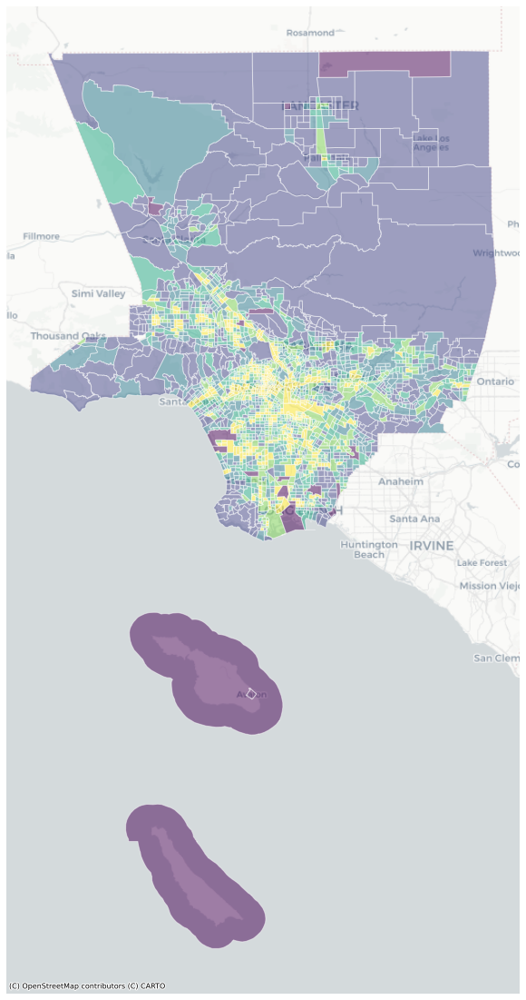

In [56]:
#Use census tracts and ejsm integrated layers to add base map
ax=census_tracts.plot(figsize=(20,20), 
                      edgecolor='white',
                      column='HazScore',
                      alpha=0.5)

ax.axis('off')

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [57]:
#Make crime GeoDataFrame
crime = gpd.GeoDataFrame(df_flat, 
                         crs='EPSG:4326',
                         geometry=gpd.points_from_xy(df_flat.lon, df_flat.lat))

In [58]:
#Convert crime to crs
crime = crime.to_crs(epsg=3857)
crime.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 29220 entries, 0 to 29219
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   FIPS             29220 non-null  object  
 1   grp_description  29220 non-null  object  
 2   lat              29220 non-null  float64 
 3   lon              29220 non-null  float64 
 4   arst_date        29220 non-null  object  
 5   rpt_id           29220 non-null  int64   
 6   geometry         29220 non-null  geometry
dtypes: float64(2), geometry(1), int64(1), object(3)
memory usage: 1.6+ MB


In [59]:
#Use geometry to define area
crime.geometry.total_bounds

array([-13209059.45803905,   3989526.81108362, -13153165.94171174,
         4072970.3446184 ])

In [60]:
#Print total bounds
minx, miny, maxx, maxy = crime.geometry.total_bounds
print(minx)
print(maxx)
print(miny)
print(maxy)

-13209059.458039049
-13153165.941711744
3989526.8110836204
4072970.344618399


### Function maps

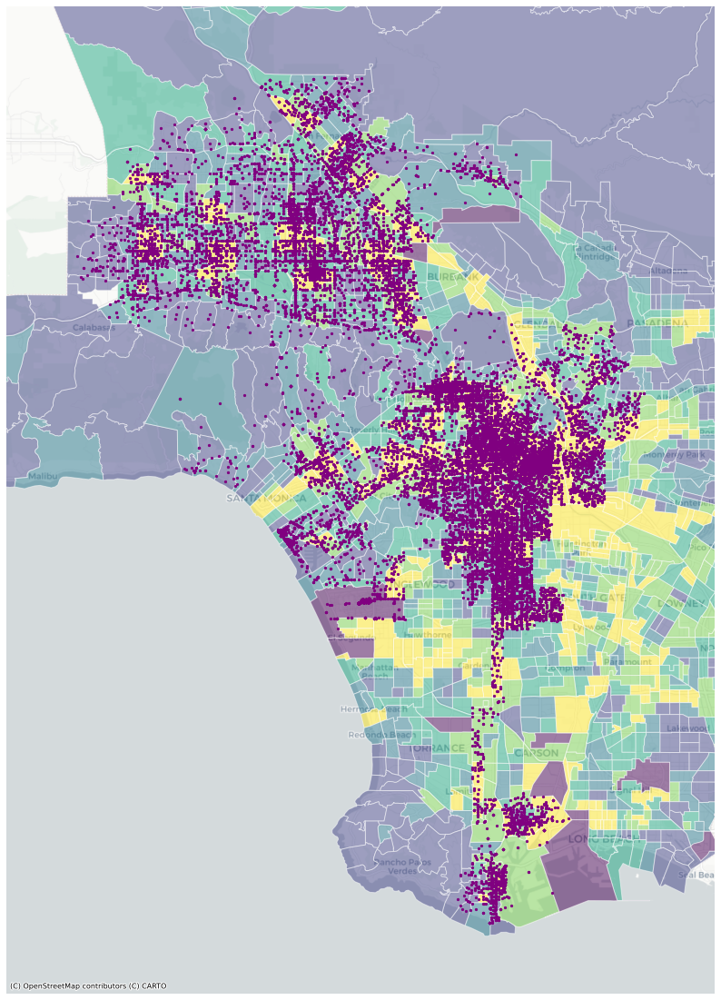

In [61]:
#Configure function map by census tracts as the base map
base = census_tracts.plot(figsize=(20,20), 
                      edgecolor='white',
                      column='HazScore',
                      alpha=0.5)

ax = crime.plot(ax=base, marker='o', color='purple', markersize=5)

ax.set_xlim(minx - 7000, maxx + 7000) 
ax.set_ylim(miny - 7000, maxy + 7000)

ax.axis('off')

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)


In [62]:
#Define bounds for the map using the function
crime.geometry.total_bounds
minx, miny, maxx, maxy = crime.geometry.total_bounds
print(minx)
print(maxx)
print(miny)
print(maxy)

-13209059.458039049
-13153165.941711744
3989526.8110836204
4072970.344618399


In [63]:
def map_arrests_by_type(charge='Aggravated Assault'):
    
    crime_type = crime[crime.grp_description==charge]

    minx, miny, maxx, maxy = crime_type.geometry.total_bounds
    
    arrests_in_tracts = gpd.sjoin(census_tracts,crime_type,how='right')

    base = census_tracts.plot(figsize=(20,20), 
                    edgecolor='white',
                    column='HazScore',
                    alpha=0.5)

    ax = arrests_in_tracts.plot(ax=base, 
                                    column='grp_description',
                                    marker='o',
                                    markersize=40, 
                                    legend=True,
                                    cmap='tab20',
                                    legend_kwds={
                                       'loc': 'upper right',
                                       'bbox_to_anchor':(1.3,1)
                                    }                  # this puts the legend to the side
                                )

    ax.set_xlim(minx - 200, maxx + 200) # added/substracted value is to give some margin around total bounds
    ax.set_ylim(miny - 200, maxy + 200)

    ax.axis('off')

    ax.set_title('Occurences of '+crime.grp_description.values[0]+' in Los Angeles',fontsize=20)

    ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)
    ax

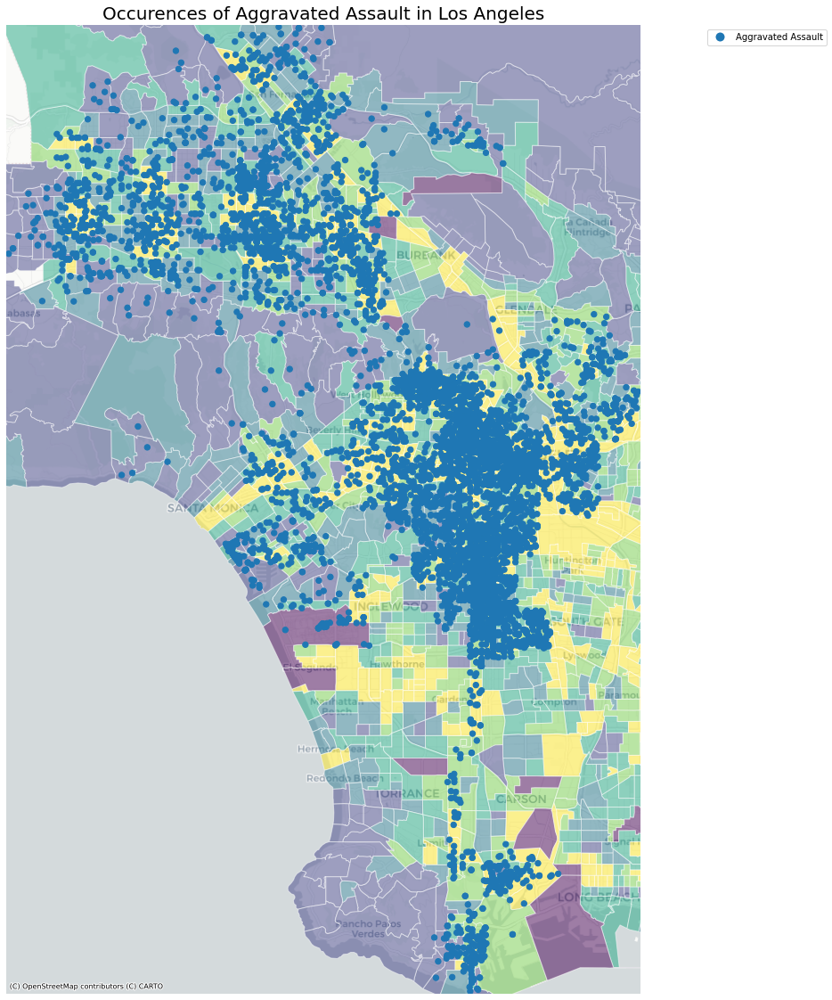

In [64]:
#Map arrests by using the function
map_arrests_by_type(charge='Aggravated Assault')

We've laid out the function of our maps to find out the crimes by type as a function, using eJ scores as a base. We still can't tell if there is a statistically significant relationship bertween the two especially because the points overlap with each other and simultaenously obscure our EJ census tracts. 

# Seaborn plots

We've already uploaded Seaborn and all the relevant packages 

In [65]:
#slice datadf
map_arrests_by_type = crime[crime.grp_description== 'Aggravated Assault'].head()

In [66]:
#map arrests by type info- this is a subset of crime ag-- i dont think i understand this
map_arrests_by_type.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 5 entries, 0 to 17
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   FIPS             5 non-null      object  
 1   grp_description  5 non-null      object  
 2   lat              5 non-null      float64 
 3   lon              5 non-null      float64 
 4   arst_date        5 non-null      object  
 5   rpt_id           5 non-null      int64   
 6   geometry         5 non-null      geometry
dtypes: float64(2), geometry(1), int64(1), object(3)
memory usage: 320.0+ bytes


In [67]:
#current df
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 31826 entries, 5567 to 31632
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   arst_date        31826 non-null  object  
 1   rpt_id           31826 non-null  object  
 2   grp_description  31826 non-null  object  
 3   arst_typ_cd      31826 non-null  object  
 4   HazScore         31600 non-null  float64 
 5   CIscore          31600 non-null  float64 
 6   FIPS             31600 non-null  object  
 7   lat              31826 non-null  float64 
 8   lon              31826 non-null  float64 
 9   geometry         31826 non-null  geometry
dtypes: float64(4), geometry(1), object(5)
memory usage: 2.7+ MB


In [68]:
#slice data- needs help
df[df.grp_description == 'Aggravated Assault'].head()

,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,FIPS,lat,lon,geometry
2862,2020-10-01T00:00:00.000,6023564,Aggravated Assault,F,3.0,10.0,06037101110,34.2567,-118.3002,POINT (-118.30020 34.25670)
7469,2020-08-18T00:00:00.000,5994330,Aggravated Assault,F,3.0,10.0,06037101110,34.2588,-118.2979,POINT (-118.29790 34.25880)
22996,2020-03-05T00:00:00.000,5893685,Aggravated Assault,F,3.0,10.0,06037101110,34.2632,-118.2957,POINT (-118.29570 34.26320)
13784,2020-06-09T00:00:00.000,5951608,Aggravated Assault,F,3.0,10.0,06037101110,34.2611,-118.2857,POINT (-118.28570 34.26110)
14282,2020-06-02T00:00:00.000,5947554,Aggravated Assault,F,1.0,4.0,06037101122,34.2655,-118.2931,POINT (-118.29310 34.26550)


In [69]:
#ag converted- gpd points
df = gpd.GeoDataFrame(df, 
                     crs='EPSG:4326',
                     geometry=gpd.points_from_xy(df.lon, df.lat))

In [70]:
df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 31826 entries, 5567 to 31632
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   arst_date        31826 non-null  object  
 1   rpt_id           31826 non-null  object  
 2   grp_description  31826 non-null  object  
 3   arst_typ_cd      31826 non-null  object  
 4   HazScore         31600 non-null  float64 
 5   CIscore          31600 non-null  float64 
 6   FIPS             31600 non-null  object  
 7   lat              31826 non-null  float64 
 8   lon              31826 non-null  float64 
 9   geometry         31826 non-null  geometry
dtypes: float64(4), geometry(1), object(5)
memory usage: 2.7+ MB


In [71]:
#Change df to crs (web mercator for seaborne)
df=df.to_crs('EPSG:3857')

In [72]:
#Make x and y variables with only aggravated assault 
df['x'] = df.geometry.x
df['y'] = df.geometry.y
df[df.grp_description == 'Aggravated Assault'].head()

,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,FIPS,lat,lon,geometry,x,y
2862,2020-10-01T00:00:00.000,6023564,Aggravated Assault,F,3.0,10.0,06037101110,34.2567,-118.3002,POINT (-13169118.025 4063322.867),-1.316912e+07,4.063323e+06
7469,2020-08-18T00:00:00.000,5994330,Aggravated Assault,F,3.0,10.0,06037101110,34.2588,-118.2979,POINT (-13168861.990 4063605.707),-1.316886e+07,4.063606e+06
22996,2020-03-05T00:00:00.000,5893685,Aggravated Assault,F,3.0,10.0,06037101110,34.2632,-118.2957,POINT (-13168617.087 4064198.346),-1.316862e+07,4.064198e+06
13784,2020-06-09T00:00:00.000,5951608,Aggravated Assault,F,3.0,10.0,06037101110,34.2611,-118.2857,POINT (-13167503.892 4063915.492),-1.316750e+07,4.063915e+06
14282,2020-06-02T00:00:00.000,5947554,Aggravated Assault,F,1.0,4.0,06037101122,34.2655,-118.2931,POINT (-13168327.656 4064508.147),-1.316833e+07,4.064508e+06


In [73]:
#data mini 
data_mini = df[df.grp_description.isin(['Aggravated Assault'])]
data_mini.head()

,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,FIPS,lat,lon,geometry,x,y
2862,2020-10-01T00:00:00.000,6023564,Aggravated Assault,F,3.0,10.0,06037101110,34.2567,-118.3002,POINT (-13169118.025 4063322.867),-1.316912e+07,4.063323e+06
7469,2020-08-18T00:00:00.000,5994330,Aggravated Assault,F,3.0,10.0,06037101110,34.2588,-118.2979,POINT (-13168861.990 4063605.707),-1.316886e+07,4.063606e+06
22996,2020-03-05T00:00:00.000,5893685,Aggravated Assault,F,3.0,10.0,06037101110,34.2632,-118.2957,POINT (-13168617.087 4064198.346),-1.316862e+07,4.064198e+06
13784,2020-06-09T00:00:00.000,5951608,Aggravated Assault,F,3.0,10.0,06037101110,34.2611,-118.2857,POINT (-13167503.892 4063915.492),-1.316750e+07,4.063915e+06
14282,2020-06-02T00:00:00.000,5947554,Aggravated Assault,F,1.0,4.0,06037101122,34.2655,-118.2931,POINT (-13168327.656 4064508.147),-1.316833e+07,4.064508e+06


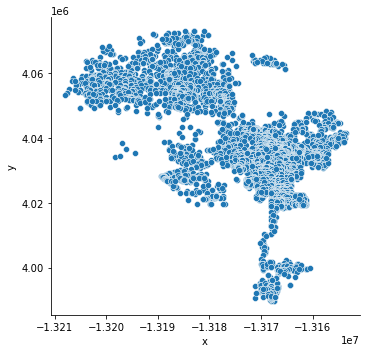

In [74]:
#uses xand y from mini
sns.relplot(data=data_mini,
            x='x', 
            y='y')

In [75]:
#Interactive seaborne map
@interact
def sns_styles(style=['darkgrid', 'whitegrid', 'dark', 'white', 'ticks']):
    # seaborn comes with themes to make them prettier
    sns.set_style(style)

    # scatterplot 
    sns.relplot(data=data_mini,
                x='x', 
                y='y')

interactive(children=(Dropdown(description='style', options=('darkgrid', 'whitegrid', 'dark', 'white', 'ticks'…

In [76]:
#Find centrography of map
mean_center = centrography.mean_center(df[['x','y']])
med_center = centrography.euclidean_median(df[['x','y']])

From this point on we attempt to figure out the median and mean point of our data. These will help us identify where the central tendency of the crimes occur. As we start to explore this data key hubs and center points start to become apparent. With further insight a lot of these hubs are linked to key contaminant sites and align 

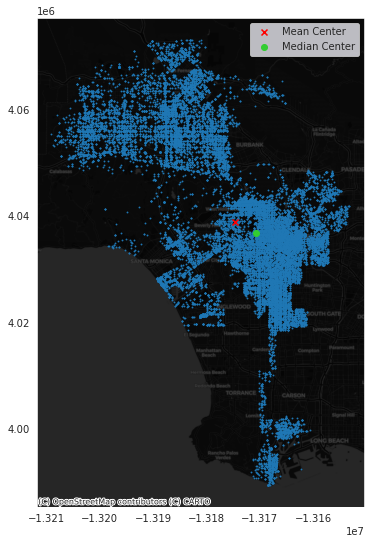

In [77]:
#map the mean center and median center of map
sns.set_style('dark')

# Set up figure and axis
f, ax = plt.subplots(1, figsize=(9, 9))

# Plot points
ax.scatter(df['x'], df['y'], s=0.75)
ax.scatter(*mean_center, color='red', marker='x', label='Mean Center')
ax.scatter(*med_center, color='limegreen', marker='o', label='Median Center')

ax.legend()

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.DarkMatter)
# Display
plt.show()

In [78]:
#set orientation
major, minor, rotation = centrography.ellipse(df[['x','y']])

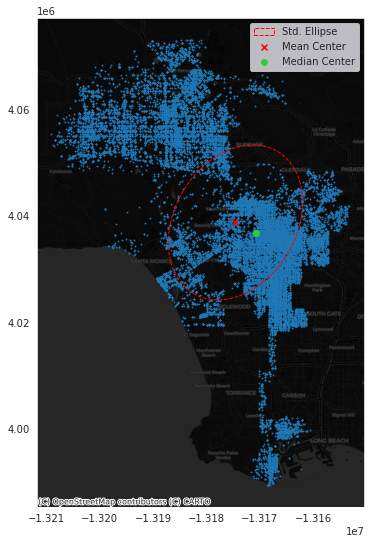

In [79]:
# set the style without grid lines- 
sns.set_style('dark')

# Set up figure and axis
f, ax = plt.subplots(1, figsize=(9, 9))

# Plot points
ax.scatter(df['x'], df['y'], s=0.75)
ax.scatter(*mean_center, color='red', marker='x', label='Mean Center')
ax.scatter(*med_center, color='limegreen', marker='o', label='Median Center')

# Construct the standard ellipse using matplotlib
ellipse = Ellipse(xy=mean_center, # center the ellipse on our mean center
                  width=major*2, # centrography.ellipse only gives half the axis
                  height=minor*2, 
                  angle = np.rad2deg(rotation), # Angles for this are in degrees, not radians
                  facecolor='none', 
                  edgecolor='red', linestyle='--',
                  label='Std. Ellipse')

ax.add_patch(ellipse)

ax.legend()

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.DarkMatter)

# Display
plt.show()

This map displays the concentration of arrests with the median center and mean center. The ellipse provides a general idea about the concentration of charges. However, it is better to use the median for our analysis going forward to avoid the outliers. 

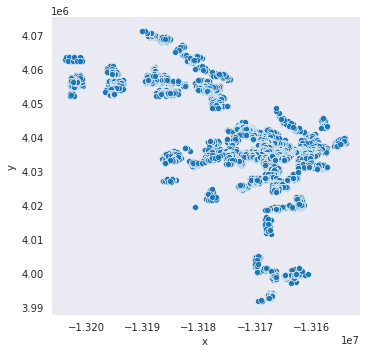

In [80]:
#clusters show all crimes in tracts where the haz score is greater than 4
sns.relplot(data=df[df['HazScore']>4],
            x='x', 
            y='y')

This plot describes are crimes where hazscores are above four

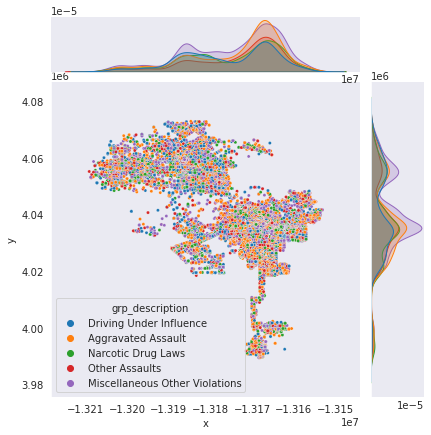

In [81]:
#Seaborne map 
g = sns.jointplot(data = df,
                  x='x', 
                  y='y',
                  hue='grp_description',
                  s=10)

This seaborn plot shows the concentration of different charge types in Los Angeles. On the sides of the map, we can see how the concentrations are higher in areas closer to the center of the map. Instances of aggravated assualt are higher in central LA. Despite not having a basemap, this KDE plot is useful in rendering an overall view that describes the distribution of charges. 

In [82]:
#make df to gdf from hazscore per tract estimation? to normalize data?
df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 31826 entries, 5567 to 31632
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   arst_date        31826 non-null  object  
 1   rpt_id           31826 non-null  object  
 2   grp_description  31826 non-null  object  
 3   arst_typ_cd      31826 non-null  object  
 4   HazScore         31600 non-null  float64 
 5   CIscore          31600 non-null  float64 
 6   FIPS             31600 non-null  object  
 7   lat              31826 non-null  float64 
 8   lon              31826 non-null  float64 
 9   geometry         31826 non-null  geometry
 10  x                31826 non-null  float64 
 11  y                31826 non-null  float64 
dtypes: float64(6), geometry(1), object(5)
memory usage: 3.2+ MB


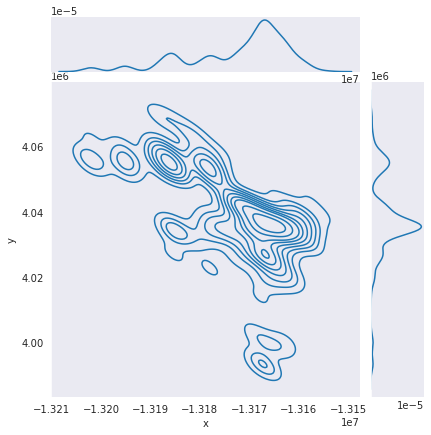

In [83]:
#exploration with hazscore 
sns.jointplot(data=df[df['HazScore']>4],
              x='x', 
              y='y', 
              kind='kde')
ax.axis('off')

ctx.add_basemap(ax,source=ctx.providers.CartoDB.DarkMatter)

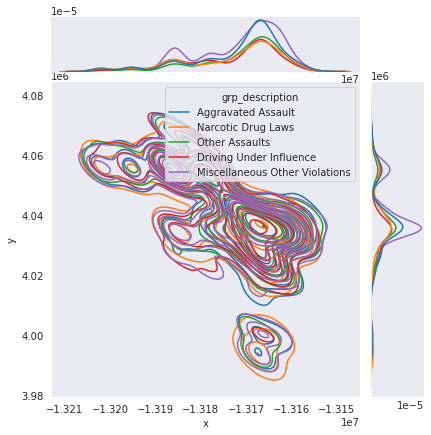

In [84]:
#exploration with hazscore- need to figure out how to explore this better. change Hazscore? create ratio? isolate grp description for crie 
sns.jointplot(data=df[df['HazScore']>4],
              x='x', 
              y='y', 
              kind='kde',
              hue='grp_description')
ax.axis('off')

ctx.add_basemap(ax,source=ctx.providers.CartoDB.DarkMatter)

In [85]:
#check df
df.head()

,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,FIPS,lat,lon,geometry,x,y
5567,2020-09-04T00:00:00.000,6005984,Driving Under Influence,M,3.0,10.0,06037101110,34.2567,-118.3002,POINT (-13169118.025 4063322.867),-1.316912e+07,4.063323e+06
2862,2020-10-01T00:00:00.000,6023564,Aggravated Assault,F,3.0,10.0,06037101110,34.2567,-118.3002,POINT (-13169118.025 4063322.867),-1.316912e+07,4.063323e+06
25845,2020-02-13T00:00:00.000,201605850,Narcotic Drug Laws,M,3.0,10.0,06037101110,34.2575,-118.3010,POINT (-13169207.080 4063430.614),-1.316921e+07,4.063431e+06
7469,2020-08-18T00:00:00.000,5994330,Aggravated Assault,F,3.0,10.0,06037101110,34.2588,-118.2979,POINT (-13168861.990 4063605.707),-1.316886e+07,4.063606e+06
7745,2020-08-15T00:00:00.000,5992659,Driving Under Influence,F,3.0,10.0,06037101110,34.2560,-118.2932,POINT (-13168338.788 4063228.588),-1.316834e+07,4.063229e+06


In [86]:
@interact
def charge_ellipse(charge=df.grp_description.unique().tolist()):
    # filter the data by race
    charge_filtered = df[df.grp_description == charge]

    # mean center and median
    mean_center = centrography.mean_center(charge_filtered[['x','y']])
    med_center = centrography.euclidean_median(charge_filtered[['x','y']])

    # standard ellipse
    major, minor, rotation = centrography.ellipse(charge_filtered[['x','y']])

    # Set up figure and axis
    f, ax = plt.subplots(1, figsize=(9, 9))

    # plot arrest points
    ax.scatter(charge_filtered['x'], charge_filtered['y'], s=0.75)

    # add the mean and median center points
    ax.scatter(*mean_center, color='red', marker='x', label='Mean Center')
    ax.scatter(*med_center, color='limegreen', marker='o', label='Median Center')

    # heatmap
    sns.kdeplot(x = charge_filtered.geometry.x, 
                y = charge_filtered.geometry.y,
                n_levels=20, 
                shade=False,
                thresh=0.1,
                alpha=0.3, 
                cmap='Reds', 
                ax=ax)

    # Construct the standard ellipse using matplotlib
    ellipse = Ellipse(xy=mean_center, # center the ellipse on our mean center
                      width=major*2, # centrography.ellipse db_filtered
                      height=minor*2, 
                      angle = np.rad2deg(rotation), # Angles for this are in degrees, not radians
                      facecolor='none', 
                      edgecolor='red', linestyle='--',
                      label='Std. Ellipse')

    ax.add_patch(ellipse)

    ax.legend()

    ax.axis('Off')

    ax.set_title(str(len(charge_filtered)) + ' incidents of crime by distribution of indexed crime type "' + charge + '"') #CHANGE HERE

    # add a basemap
    ctx.add_basemap(ax,source=ctx.providers.CartoDB.DarkMatter)
    # Display
    plt.show()

interactive(children=(Dropdown(description='charge', options=('Driving Under Influence', 'Aggravated Assault',…

This heatmap displays the concentration of arrests with the median center and mean center. In the next stage of our final project we want to understand if there is a correlation between crimes by type and the proximity to hazards. It starts to become apparent through different crimes the rise of central nodes throughout the map with consistency. What makes these hubs particularly unique? What is their proximity to hazards and other envionrmental issues? 

In [87]:
#convert df to crs 
df=df.to_crs(epsg=3857)

In [88]:
#convert floats
df.lon = df.lon.astype('float')
df.lat = df.lat.astype('float')

In [89]:
df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 31826 entries, 5567 to 31632
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   arst_date        31826 non-null  object  
 1   rpt_id           31826 non-null  object  
 2   grp_description  31826 non-null  object  
 3   arst_typ_cd      31826 non-null  object  
 4   HazScore         31600 non-null  float64 
 5   CIscore          31600 non-null  float64 
 6   FIPS             31600 non-null  object  
 7   lat              31826 non-null  float64 
 8   lon              31826 non-null  float64 
 9   geometry         31826 non-null  geometry
 10  x                31826 non-null  float64 
 11  y                31826 non-null  float64 
dtypes: float64(6), geometry(1), object(5)
memory usage: 3.2+ MB


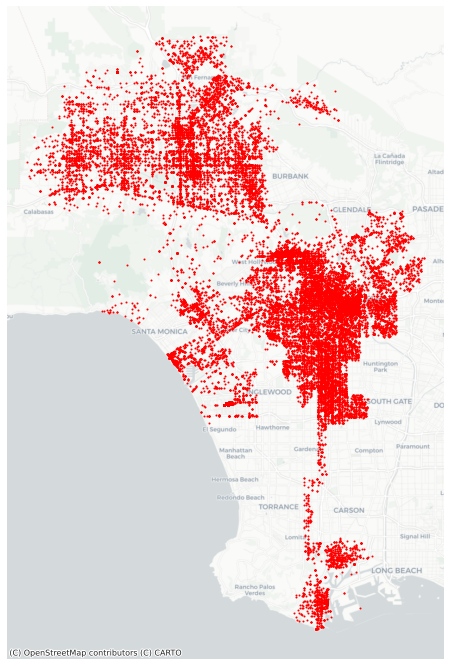

In [90]:
#plot concentrations on map with base
ax= df.plot(figsize=(12,12),
            color='red',
            markersize=1)
            
ax.axis('off')
            
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [91]:
#find bounds for map
minx, miny, maxx, maxy = df.geometry.total_bounds
print(minx)
print(maxx)
print(miny)
print(maxy)

-13209059.458039049
-13153165.941711744
3989526.8110836204
4072970.344618399


# Consolidating the data for spatial autocorrelations

In [92]:
#rereading the geojson files to create a new dataframe for the spatial autocorrelation
tracts_ejsm=gpd.read_file('tracts_ejsm.geojson')

In [93]:
tracts_ejsm_subset = tracts_ejsm[['FIPS','geometry']]
tracts_ejsm_subset=tracts_ejsm_subset.to_crs(epsg=3857)
tracts_ejsm_subset.head()
tracts_ejsm_subset.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2342 entries, 0 to 2341
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   FIPS      2342 non-null   object  
 1   geometry  2342 non-null   geometry
dtypes: geometry(1), object(1)
memory usage: 36.7+ KB


In [94]:
#make gdf from df
gdf = df
gdf= gdf.drop(['geometry'], axis=1)

In [95]:
gdf.head()

,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,FIPS,lat,lon,x,y
5567,2020-09-04T00:00:00.000,6005984,Driving Under Influence,M,3.0,10.0,06037101110,34.2567,-118.3002,-1.316912e+07,4.063323e+06
2862,2020-10-01T00:00:00.000,6023564,Aggravated Assault,F,3.0,10.0,06037101110,34.2567,-118.3002,-1.316912e+07,4.063323e+06
25845,2020-02-13T00:00:00.000,201605850,Narcotic Drug Laws,M,3.0,10.0,06037101110,34.2575,-118.3010,-1.316921e+07,4.063431e+06
7469,2020-08-18T00:00:00.000,5994330,Aggravated Assault,F,3.0,10.0,06037101110,34.2588,-118.2979,-1.316886e+07,4.063606e+06
7745,2020-08-15T00:00:00.000,5992659,Driving Under Influence,F,3.0,10.0,06037101110,34.2560,-118.2932,-1.316834e+07,4.063229e+06


In [96]:
#making a subset of the df to include the multipolygon data from tracts
gdf=gdf.merge(tracts_ejsm_subset,on='FIPS')
gdf.tail()

,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,FIPS,lat,lon,x,y,geometry
31595,2020-04-24T00:00:00.000,5920521,Other Assaults,M,4.0,7.0,06037980031,33.7167,-118.2842,-1.316734e+07,3.990825e+06,"MULTIPOLYGON (((-13167459.698 3989740.651, -13..."
31596,2020-07-19T00:00:00.000,5974608,Aggravated Assault,F,4.0,7.0,06037980031,33.7167,-118.2842,-1.316734e+07,3.990825e+06,"MULTIPOLYGON (((-13167459.698 3989740.651, -13..."
31597,2020-02-02T00:00:00.000,5864491,Narcotic Drug Laws,M,4.0,7.0,06037980031,33.7167,-118.2842,-1.316734e+07,3.990825e+06,"MULTIPOLYGON (((-13167459.698 3989740.651, -13..."
31598,2020-08-15T00:00:00.000,5992477,Aggravated Assault,F,4.0,7.0,06037980031,33.7167,-118.2842,-1.316734e+07,3.990825e+06,"MULTIPOLYGON (((-13167459.698 3989740.651, -13..."
31599,2020-10-11T00:00:00.000,6030171,Miscellaneous Other Violations,F,4.0,7.0,06037980031,33.7250,-118.2825,-1.316715e+07,3.991936e+06,"MULTIPOLYGON (((-13167459.698 3989740.651, -13..."


## Making the spatial join
In this section, we needed to join the shaved down versions of our data to make the spatial analysis. By joining the data by arrest counts, we were able to make correlations between hazard score and all arrests in the given census tracts. 

In [97]:
#ERROR
tracts_ejsm_subset=tracts_ejsm_subset.to_crs(epsg=3857)
join = gpd.sjoin(tracts_ejsm_subset, gdf, how='right')
join.head()

,index_left,FIPS_x,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,FIPS_y,lat,lon,x,y,geometry
40,0,06037101110,2020-09-08T00:00:00.000,6008338,Narcotic Drug Laws,M,4.0,14.0,06037101210,34.2523,-118.2886,-1.316783e+07,4.062730e+06,"MULTIPOLYGON (((-13169034.646 4063225.625, -13..."
40,2,06037101210,2020-09-08T00:00:00.000,6008338,Narcotic Drug Laws,M,4.0,14.0,06037101210,34.2523,-118.2886,-1.316783e+07,4.062730e+06,"MULTIPOLYGON (((-13169034.646 4063225.625, -13..."
40,3,06037101220,2020-09-08T00:00:00.000,6008338,Narcotic Drug Laws,M,4.0,14.0,06037101210,34.2523,-118.2886,-1.316783e+07,4.062730e+06,"MULTIPOLYGON (((-13169034.646 4063225.625, -13..."
40,5,06037101400,2020-09-08T00:00:00.000,6008338,Narcotic Drug Laws,M,4.0,14.0,06037101210,34.2523,-118.2886,-1.316783e+07,4.062730e+06,"MULTIPOLYGON (((-13169034.646 4063225.625, -13..."
40,14,06037103400,2020-09-08T00:00:00.000,6008338,Narcotic Drug Laws,M,4.0,14.0,06037101210,34.2523,-118.2886,-1.316783e+07,4.062730e+06,"MULTIPOLYGON (((-13169034.646 4063225.625, -13..."


In [98]:
#reset index to include counts
arrests_by_gdf = gdf.FIPS.value_counts().rename_axis('FIPS').reset_index(name='arrests_count')

In [99]:
#arrests by tracts
arrests_by_gdf.head()

,FIPS,arrests_count
0,06037980028,802
1,06037206300,550
2,06037207710,286
3,06037128210,265
4,06037207400,245


In [100]:
#merge arrests by FIPS to find the arrest counts to see the average in each FIPS by hazscore
gdf=gdf.merge(arrests_by_gdf,on='FIPS')
gdf.sample(5)

,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,FIPS,lat,lon,x,y,geometry,arrests_count
4525,2020-01-20T00:00:00.000,200904870,Narcotic Drug Laws,M,2.0,11.0,06037123602,34.1831,-118.4279,-1.318333e+07,4.053414e+06,"MULTIPOLYGON (((-13183705.999 4053162.286, -13...",14
16799,2020-06-23T00:00:00.000,5959573,Aggravated Assault,F,4.0,19.0,06037208801,34.0601,-118.2761,-1.316644e+07,4.036875e+06,"MULTIPOLYGON (((-13166816.494 4036814.648, -13...",171
8566,2020-02-01T00:00:00.000,5863060,Driving Under Influence,M,3.0,10.0,06037139301,34.1723,-118.5709,-1.319925e+07,4.051961e+06,"MULTIPOLYGON (((-13199254.883 4051949.666, -13...",47
12786,2020-08-27T00:00:00.000,5999873,Driving Under Influence,M,3.0,13.0,06037197600,34.0677,-118.2520,-1.316375e+07,4.037896e+06,"MULTIPOLYGON (((-13164222.861 4037915.863, -13...",19
1222,2020-10-15T00:00:00.000,6032997,Aggravated Assault,F,1.0,4.0,06037106643,34.3013,-118.5181,-1.319337e+07,4.069331e+06,"MULTIPOLYGON (((-13195725.498 4068644.267, -13...",16


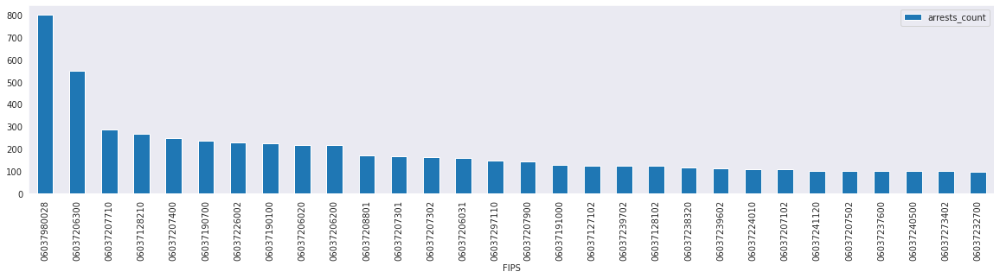

In [101]:
#describe arrests per FIPS
arrests_by_gdf[:30].plot.bar(figsize=(20,4),
                             x='FIPS',
                             y='arrests_count')

## Making a ratio by FIPS
In this section, we figured out that we needed a unit of analysis to compare out tracts data. We decided to join the arrests per hazard score data to the count data. By multiplying the data by 1000, we made the points intergers instead of floats. 

In [102]:
#gdf of arrests by Hazscore ratio
gdf['arrests_per_HazScore'] =gdf['arrests_count']/gdf['HazScore']*1000
gdf.sort_values(by="HazScore").tail()

,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,FIPS,lat,lon,x,y,geometry,arrests_count,arrests_per_HazScore
13304,2020-10-26T00:00:00.000,6040081,Narcotic Drug Laws,F,5.0,20.0,06037203200,34.0512,-118.1995,-1.315791e+07,4.035679e+06,"MULTIPOLYGON (((-13158391.056 4035923.541, -13...",39,7800.0
13303,2020-04-17T00:00:00.000,5917032,Other Assaults,M,5.0,20.0,06037203200,34.0501,-118.1970,-1.315763e+07,4.035531e+06,"MULTIPOLYGON (((-13158391.056 4035923.541, -13...",39,7800.0
13302,2020-02-23T00:00:00.000,5883282,Aggravated Assault,F,5.0,20.0,06037203200,34.0501,-118.1970,-1.315763e+07,4.035531e+06,"MULTIPOLYGON (((-13158391.056 4035923.541, -13...",39,7800.0
13300,2020-06-26T00:00:00.000,5961596,Aggravated Assault,F,5.0,20.0,06037203200,34.0497,-118.1961,-1.315753e+07,4.035477e+06,"MULTIPOLYGON (((-13158391.056 4035923.541, -13...",39,7800.0
15799,2020-02-06T00:00:00.000,5867610,Driving Under Influence,M,5.0,19.0,06037207400,34.0570,-118.2437,-1.316283e+07,4.036458e+06,"MULTIPOLYGON (((-13163900.814 4036677.994, -13...",245,49000.0


In [103]:
# getting the count of arrests by fips
gdf.groupby(['FIPS']).count()

,arst_date,rpt_id,grp_description,arst_typ_cd,HazScore,CIscore,lat,lon,x,y,geometry,arrests_count,arrests_per_HazScore
FIPS,,,,,,,,,,,,,
06037101110,17,17,17,17,17,17,17,17,17,17,17,17,17
06037101122,6,6,6,6,6,6,6,6,6,6,6,6,6
06037101210,17,17,17,17,17,17,17,17,17,17,17,17,17
06037101220,15,15,15,15,15,15,15,15,15,15,15,15,15
06037101300,10,10,10,10,10,10,10,10,10,10,10,10,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...
06037980023,1,1,1,1,1,1,1,1,1,1,1,1,1
06037980024,82,82,82,82,82,82,82,82,82,82,82,82,82
06037980026,3,3,3,3,3,3,3,3,3,3,3,3,3


In [104]:
#dropping unnescessary columns
gdf = gdf[['FIPS', 'geometry', 'arrests_count', 'arrests_per_HazScore']]
gdf.head()

,FIPS,geometry,arrests_count,arrests_per_HazScore
0,06037101110,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",17,5666.666667
1,06037101110,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",17,5666.666667
2,06037101110,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",17,5666.666667
3,06037101110,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",17,5666.666667
4,06037101110,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",17,5666.666667


## Disolving the data
This was an important step in making our autocorrelations because our data points were stacked on one another by tracts. The extras needed to be removed so that we could have one value per tract. In previous iterations of this notebook we saw a type of error occur where the topmost census tracts of arrests_per_HazScore kept piling onto the same spot. In order to distribute this we realized we had to take out values that were infinite. We believe the ratio we created would lead to infinte when the HazScore was 0. We are unsure about the logic of this, and we wonder whether it erasedd relevant data (such as the degree of policing around and within LAX. But it did allow the equations to follow and once we dropped the infinite we were able to see everything. 

In [105]:
#
gdf2 = gdf.dissolve(by='FIPS', aggfunc='mean')
gdf2.replace([np.inf, -np.inf], np.nan, inplace=True) 
gdf2.dropna(inplace=True)
gdf2.head()

,geometry,arrests_count,arrests_per_HazScore
FIPS,,,
06037101110,"POLYGON ((-13169350.794 4063591.834, -13169183...",17,5666.666667
06037101122,"POLYGON ((-13169466.900 4065590.632, -13169449...",6,6000.000000
06037101210,"POLYGON ((-13169034.646 4063225.625, -13167528...",17,4250.000000
06037101220,"POLYGON ((-13167528.828 4062280.326, -13167528...",15,5000.000000
06037101300,"POLYGON ((-13166031.469 4060067.620, -13165971...",10,10000.000000


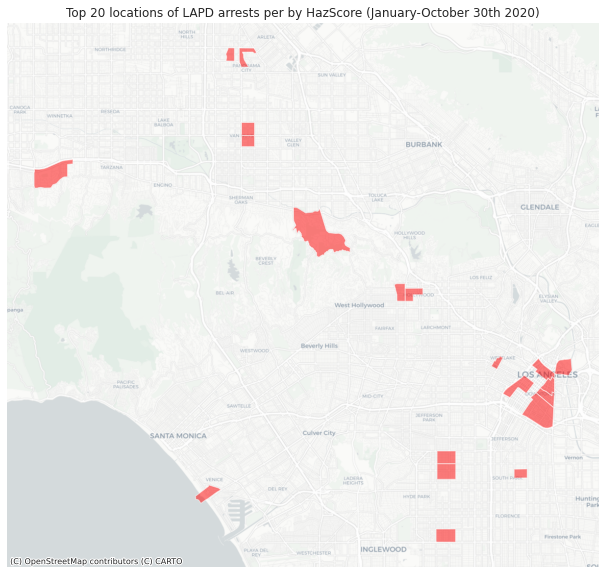

In [106]:
#Mapping the HazScore to find the top locations 
ax = gdf2.sort_values(by='arrests_per_HazScore',ascending=False)[:20].plot(figsize=(12,10),
                                                             color='red',
                                                             edgecolor='white',
                                                             alpha=0.5,legend=True)


# title
ax.set_title('Top 20 locations of LAPD arrests per by HazScore (January-October 30th 2020)')

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

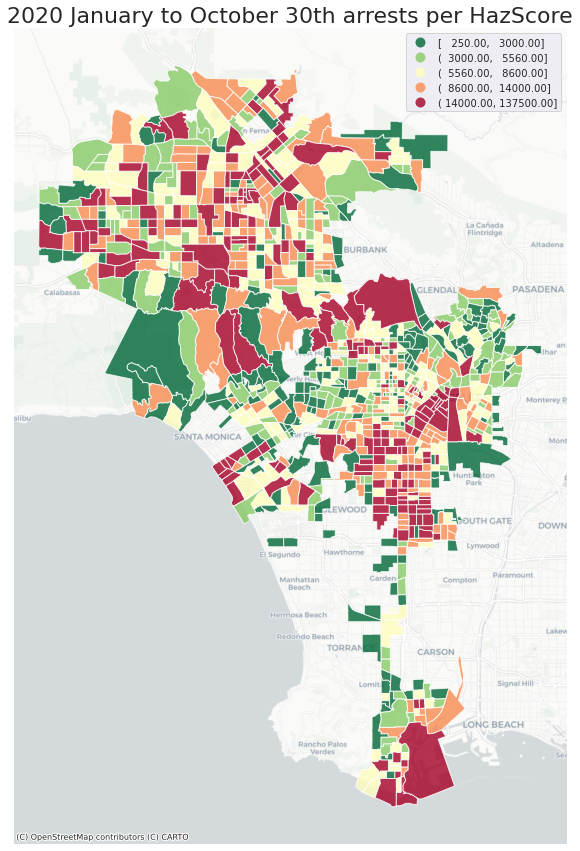

In [107]:
#arrests by Hazscores in tracts
ax = gdf2.plot(figsize=(15,15),
                        column='arrests_per_HazScore',
                        legend=True,
                        alpha=0.8,
                        cmap='RdYlGn_r',
                        scheme='quantiles')

ax.axis('off')
ax.set_title('2020 January to October 30th arrests per HazScore',fontsize=22)
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [108]:
#configuring the weights of arrests per HazScore
wq = lps.weights.KNN.from_dataframe(gdf2,k=8)
wq.transform = 'r'

In [109]:
#making dataframe for arrests per hazscore
gdf2['arrests_per_HazScore_lag'] = lps.weights.lag_spatial(wq, gdf2['arrests_per_HazScore'])
gdf2.sort_values(by='arrests_per_HazScore',ascending=False).sample(10)

,geometry,arrests_count,arrests_per_HazScore,arrests_per_HazScore_lag
FIPS,,,,
06037194402,"POLYGON ((-13177668.030 4040200.872, -13177661...",22,7333.333333,3854.166667
06037215101,"POLYGON ((-13175928.440 4037402.666, -13175928...",7,1750.000000,3670.833333
06037191420,"POLYGON ((-13168173.368 4040172.243, -13168174...",23,4600.000000,4181.250000
06037123901,"POLYGON ((-13180359.178 4053875.629, -13180398...",78,15600.000000,5977.083333
06037124104,"POLYGON ((-13178867.052 4053651.300, -13178867...",24,4800.000000,8360.416667
06037204300,"POLYGON ((-13159272.595 4034256.396, -13159050...",18,6000.000000,7956.250000
06037297300,"POLYGON ((-13172251.112 3989862.158, -13171453...",6,6000.000000,12350.000000
06037203300,"POLYGON ((-13159527.183 4036234.318, -13159542...",29,5800.000000,7460.416667
06037211420,"POLYGON ((-13169707.239 4038361.217, -13169709...",29,9666.666667,5343.750000


## Making a multilayered chloropleth map

In [110]:
token = 'pk.eyJ1IjoiYW5keWdvZ29nbyIsImEiOiJja2ljcWszMjAwd3BuMnhuejU4YzBybXB3In0.vamg0myvZOurK_nS85vodQ'
px.set_mapbox_access_token(token)

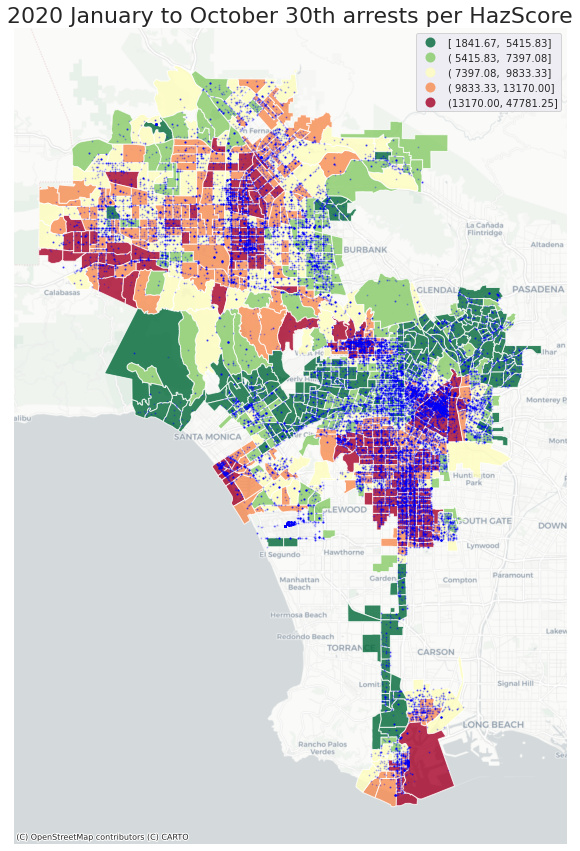

In [111]:
# use subplots that make it easier to create multiple layered maps
fig, ax = plt.subplots(figsize=(15, 15))

# spatial lag choropleth
gdf2.plot(ax=ax,
         figsize=(15,15),
         column='arrests_per_HazScore_lag',
         legend=True,
         alpha=0.8,
         cmap='RdYlGn_r',
         scheme='quantiles')

# uncomment this to see the actual point locations of arrests
df.plot(ax=ax, 
              color='blue',
              markersize =1,
              alpha=0.2, 
              legend=True)

ax.axis('off')
ax.set_title('2020 January to October 30th arrests per HazScore',fontsize=22)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

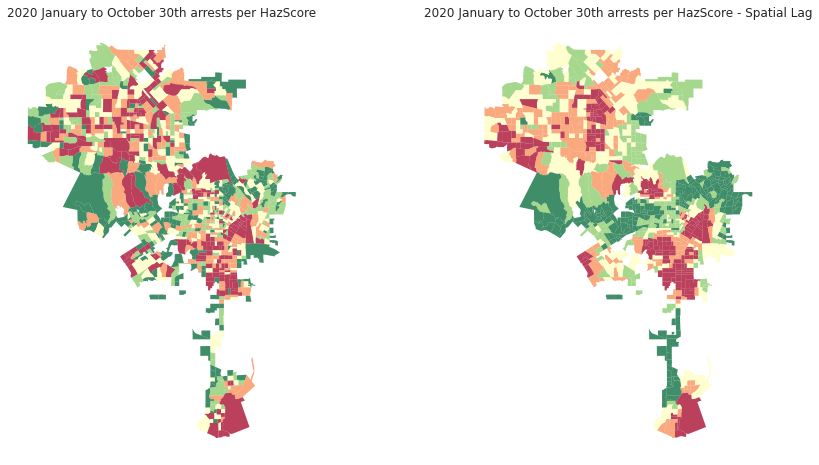

In [112]:
#creating subplots to compare the data using a lag
fig, axs = plt.subplots(1, 2, figsize=(15, 8))

# name each subplot
ax1, ax2 = axs

# regular count map on the left
gdf2.plot(column='arrests_per_HazScore', 
            cmap='RdYlGn_r', 
            scheme='quantiles',
            k=5, 
            edgecolor='white', 
            linewidth=0., 
            alpha=0.75, 
            ax=ax1 # this assigns the map to the subplot
           )


ax1.axis("off")
ax1.set_title("2020 January to October 30th arrests per HazScore")

# spatial lag map on the right
gdf2.plot(column='arrests_per_HazScore_lag', 
            cmap='RdYlGn_r', 
            scheme='quantiles',
            k=5, 
            edgecolor='white', 
            linewidth=0., 
            alpha=0.75, 
            ax=ax2 # this assigns the map to the subplot
           )

ax2.axis("off")
ax2.set_title("2020 January to October 30th arrests per HazScore - Spatial Lag")

plt.show()

In [113]:
#converting the data to crs data
gdf2_web = gdf2.to_crs('EPSG:4326')

In [114]:
minx, miny, maxx, maxy = gdf2_web.geometry.total_bounds
center_lat_gdf2_web = (maxy-miny)/2+miny
center_lon_gdf2_web = (maxx-minx)/2+minx

In [115]:
gdf2_web.arrests_per_HazScore_lag.describe()

count     1040.000000
mean      9668.561699
std       5502.280864
min       1841.666667
25%       5941.666667
50%       8464.583333
75%      12144.791667
max      47781.250000
Name: arrests_per_HazScore_lag, dtype: float64

In [116]:
#Arrests per hazard score with spatial lag
median = gdf2_web.arrests_per_HazScore_lag.median()

fig = px.choropleth_mapbox(gdf2_web, 
                     geojson=gdf2_web.geometry, 
                     locations=gdf2_web.index, 
                     mapbox_style="satellite-streets",
                     zoom=9, 
                     color='arrests_per_HazScore_lag',
                     color_continuous_scale='RdYlGn_r',
                     color_continuous_midpoint =median,
                     range_color =(0,median*2),
                     hover_data=['arrests_count','arrests_per_HazScore','arrests_per_HazScore_lag'],
                     center = {"lat": center_lat_gdf2_web, "lon": center_lon_gdf2_web},
                     opacity=0.8,
                     width=1000,
                     height=800,
                     labels={
                             'arrests_per_HazScore_lag':'Arrests per Hazard Score (Spatial Lag)',
                             'arrests_per_HazScore':'Arrests per Hazard Score',
                     })
fig.update_traces(marker_line_width=0.1, marker_line_color='white')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

# Statistical analysis- Moran's plot
Using descriptive statistics, we were able to get a full picture of which areas showed a higher correlation between hazard sores and number of arrests. 

In [117]:
#Detecting clustering
y = gdf2.arrests_per_HazScore
moran = Moran(y, wq)
moran.I

0.2852276396882286

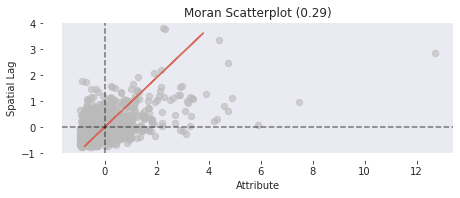

In [118]:
#showing attributes by using the lag table
fig, ax = moran_scatterplot(moran, aspect_equal=True)
plt.show()

/opt/conda/lib/python3.8/site-packages/splot/_viz_esda_mpl.py:47: MatplotlibDeprecationWarning:


The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.

/opt/conda/lib/python3.8/site-packages/splot/_viz_esda_mpl.py:48: MatplotlibDeprecationWarning:


The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.



(<Figure size 504x504 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7fdec4bc65b0>)

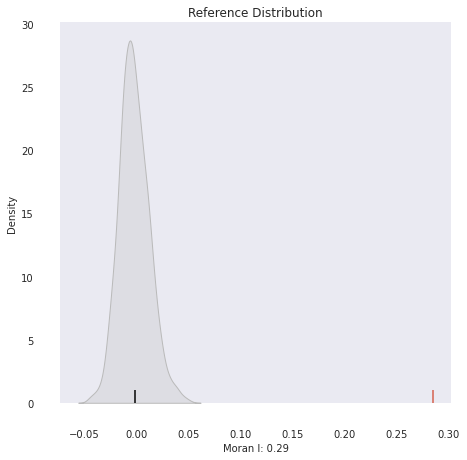

In [119]:
#Showing the distributions of statistically significant data
plot_moran_simulation(moran,aspect_equal=False)

In [120]:
#simulating the data
moran.p_sim

0.001

In [121]:
#making a cluster plot 
lisa = esda.moran.Moran_Local(y, wq)

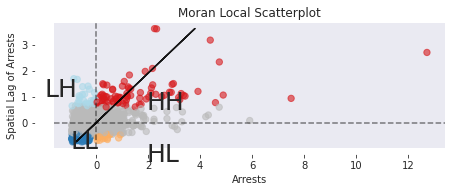

In [122]:
# Plot using clusters
fig, ax = moran_scatterplot(lisa, p=0.05)
ax.set_xlabel("Arrests")
ax.set_ylabel('Spatial Lag of Arrests')
plt.text(1.95, 0.5, "HH", fontsize=25)
plt.text(1.95, -1.5, "HL", fontsize=25)
plt.text(-2, 1, "LH", fontsize=25)
plt.text(-1, -1, "LL", fontsize=25)
plt.show()

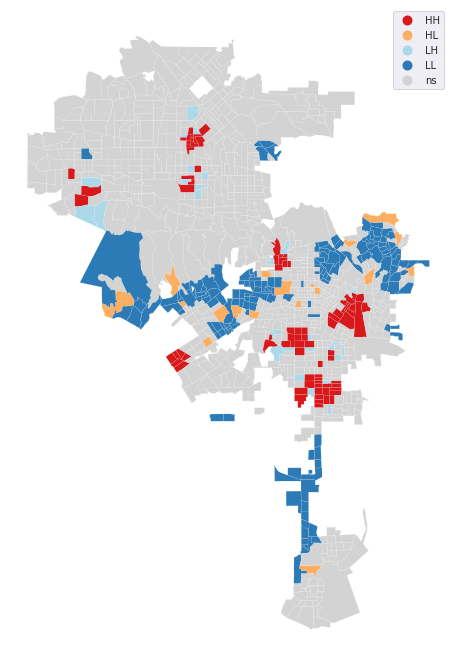

In [123]:
#showing statistically significant data by level of significance (or almost significance)
fig, ax = plt.subplots(figsize=(14,12))
lisa_cluster(lisa, gdf2, p=0.05, ax=ax)
plt.show()

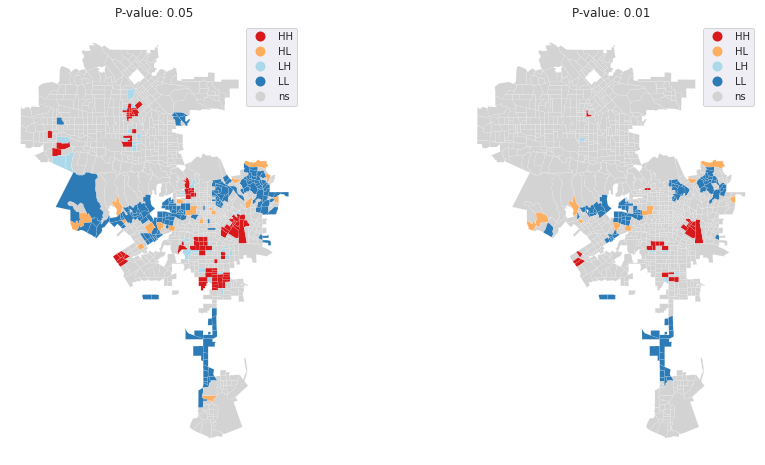

In [124]:
#subplots by p-values .005 and .01

# create the 1x2 subplots
fig, axs = plt.subplots(1, 2, figsize=(15, 8))

# name each subplot
ax1, ax2 = axs

# regular count map on the left
lisa_cluster(lisa, gdf2, p=0.05, ax=ax1)

ax1.axis("off")
ax1.set_title("P-value: 0.05")

# spatial lag map on the right
lisa_cluster(lisa, gdf2, p=0.01, ax=ax2)
ax2.axis("off")
ax2.set_title("P-value: 0.01")

plt.show()

In [125]:
## LISA- Local Spatial Autocorrelations

In [126]:
#making arrays of the local spatial autocorrelations
lisa.y[:5]

array([ 5666.66666667,  6000.        ,  4250.        ,  5000.        ,
       10000.        ])

In [127]:
#lisa.q: quadrant list
lisa.q[:5]

array([3, 3, 3, 3, 4])

In [128]:
#lisa.p_sim: p-value list
lisa.p_sim[:5]

array([0.162, 0.27 , 0.305, 0.287, 0.216])

In [129]:
#converting the gdf to quadrant list for legibility
gdf2['q'] = lisa.q.tolist()

In [130]:
#converting the gdf to quadrant list for legibility
gdf2['p_sim'] = lisa.p_sim.tolist()

In [131]:
gdf2.head()

,geometry,arrests_count,arrests_per_HazScore,arrests_per_HazScore_lag,q,p_sim
FIPS,,,,,,
06037101110,"POLYGON ((-13169350.794 4063591.834, -13169183...",17,5666.666667,6260.416667,3,0.162
06037101122,"POLYGON ((-13169466.900 4065590.632, -13169449...",6,6000.000000,7177.083333,3,0.270
06037101210,"POLYGON ((-13169034.646 4063225.625, -13167528...",17,4250.000000,7437.500000,3,0.305
06037101220,"POLYGON ((-13167528.828 4062280.326, -13167528...",15,5000.000000,7343.750000,3,0.287
06037101300,"POLYGON ((-13166031.469 4060067.620, -13165971...",10,10000.000000,6718.750000,4,0.216


In [132]:
# identifying the hotspots that demonstrate statistical significance
hot_spots = gdf2[(gdf2.p_sim < 0.05) & (gdf2.q == 1)]

In [133]:
hot_spots.shape

(82, 6)

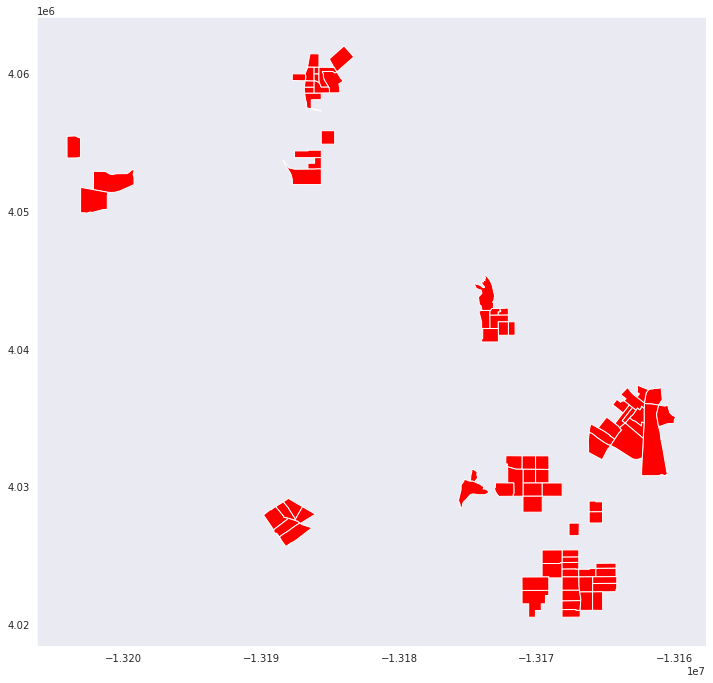

In [134]:
#plotting the hotspots
hot_spots.plot(figsize=(12,12),color='red',legend=True,categorical=True)

In [135]:
#converting the hotspot set for complatibility
hot_spots = hot_spots.to_crs('EPSG:4326')

In [136]:
#matching the bounds and limiting the data
minx, miny, maxx, maxy = hot_spots.geometry.total_bounds
center_lat_hot_spots = (maxy-miny)/2+miny
center_lon_hot_spots = (maxx-minx)/2+minx

# Final chloropleth map
What a beauty. This map shows that we were able to make a correlation that there are higher numbers of arrests per hazard score. 

In [137]:
#chloropleth map
fig = px.choropleth_mapbox(hot_spots, 
                     geojson=hot_spots.geometry, 
                     locations=hot_spots.index, 
                     mapbox_style="satellite-streets",
                     center = {"lat": center_lat_hot_spots, "lon": center_lon_hot_spots},
                     zoom=9, 
                     opacity=0.6,
                     color='arrests_per_HazScore_lag',
                     color_continuous_scale='RdYlGn_r',
                     color_continuous_midpoint =median,
                     range_color =(0,median*2),
                     hover_data=['arrests_count','arrests_per_HazScore','arrests_per_HazScore_lag'],
                     labels={
                             'arrests_per_HazScore_lag':'Arrests per Hazard Score (Spatial Lag)',
                             'arrests_per_HazScore':'Arrests per 1000',
                     })
fig.update_traces(marker_line_width=1, marker_line_color='white')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

# Conclusion
We have no been able to distinguish key regions across LA that with 99% statistical confidencce have a positive relationship between policing, as defined by our index values, and proximity to environmental hazards. While this research would require qualitative methods to further understand the histories and context of these spaces, some reflect already apparent inequities in the environment, such as in South, South Central, and East LA, where industrial plants and other source of contamination are present. Many of the areas with a statistically significant positive relationship are also all located next to a freeway and make reflect the impact of PM 2.5 and other contaminants. 

Description of labor:
AG: fixed the sample size of data and did explorations with the heatmap and KDE plot
DH:seaborn maps and data exploration